# Configuation

In [1]:
# System and utilities
import os
import re
import time
import io
import base64
from collections import Counter

# Data manipulation and analysis
import numpy as np
import pandas as pd
from scipy.stats import entropy, kstest, linregress
from sklearn.metrics import r2_score

# Natural Language Processing (NLP)
import nltk
import spacy
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

# Machine Learning & Modeling
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

# Image processing and display
from PIL import Image
from IPython.display import display
from IPython.core.display import HTML

# Progress bars
from tqdm import tqdm

# Custom modules
from auto_translate import AutoTranslate

# Data discovery

In [2]:
DATA_PATH = '../data/'

X_train = pd.read_csv(DATA_PATH + 'X_train_update.csv')
X_test = pd.read_csv(DATA_PATH + 'X_test_update.csv')
Y_train = pd.read_csv(DATA_PATH + 'Y_train_CVw08PX.csv')

tables = [('X_train', X_train), ('X_test', X_test), ('Y_train', Y_train)]

for table_name, table in tables:
    print("\n"+"=" * 120)
    print(f"\n{table_name}\n");
    display(table.head());
    display(table.info());
    print(f"\nDuplicates:\n{table.duplicated().sum()}")


X_train = X_train.merge(Y_train, how='left', left_index=True, right_index=True, suffixes=('_X_train', '_Y_train'))
X_train = X_train.drop(['Unnamed: 0_Y_train', 'prdtypecode_Y_train', 'Unnamed: 0_X_train'], axis=1, errors='ignore')

display(X_train.head(10))



X_train



,Unnamed: 0,designation,description,productid,imageid
0,0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046
1,1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237
2,2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978
3,3,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,50418756,457047496
4,4,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,278535884,1077757786


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84916 entries, 0 to 84915
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   84916 non-null  int64 
 1   designation  84916 non-null  object
 2   description  55116 non-null  object
 3   productid    84916 non-null  int64 
 4   imageid      84916 non-null  int64 
dtypes: int64(3), object(2)
memory usage: 3.2+ MB


None


Duplicates:
0


X_test



,Unnamed: 0,designation,description,productid,imageid
0,84916,Folkmanis Puppets - 2732 - Marionnette Et Théâ...,NaN,516376098,1019294171
1,84917,Porte Flamme Gaxix - Flamebringer Gaxix - 136/...,NaN,133389013,1274228667
2,84918,Pompe de filtration Speck Badu 95,NaN,4128438366,1295960357
3,84919,Robot de piscine électrique,<p>Ce robot de piscine d&#39;un design innovan...,3929899732,1265224052
4,84920,Hsm Destructeur Securio C16 Coupe Crois¿E: 4 X...,NaN,152993898,940543690


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13812 entries, 0 to 13811
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   13812 non-null  int64 
 1   designation  13812 non-null  object
 2   description  8926 non-null   object
 3   productid    13812 non-null  int64 
 4   imageid      13812 non-null  int64 
dtypes: int64(3), object(2)
memory usage: 539.7+ KB


None


Duplicates:
0


Y_train



,Unnamed: 0,prdtypecode
0,0,10
1,1,2280
2,2,50
3,3,1280
4,4,2705


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84916 entries, 0 to 84915
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype
---  ------       --------------  -----
 0   Unnamed: 0   84916 non-null  int64
 1   prdtypecode  84916 non-null  int64
dtypes: int64(2)
memory usage: 1.3 MB


None


Duplicates:
0


,designation,description,productid,imageid,prdtypecode
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50
3,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,50418756,457047496,1280
4,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,278535884,1077757786,2705
5,Afrique Contemporaine N° 212 Hiver 2004 - Doss...,NaN,5862738,393356830,2280
6,Christof E: Bildungsprozessen Auf Der Spur,NaN,91920807,907794536,10
7,Conquérant Sept Cahier Couverture Polypro 240 ...,CONQUERANT CLASSIQUE Cahier 240 x 320 mm seyès...,344240059,999581347,2522
8,Puzzle Scooby-Doo Avec Poster 2x35 Pieces,NaN,4239126071,1325918866,1280
9,Tente Pliante V3s5-Pro Pvc Blanc - 3 X 4m50 - ...,Tente pliante V3S5 Pro PVC 500 gr/m² - 3 x 4m5...,3793572222,1245644185,2582


In [3]:
print("At first glance, we notice the significant number of null values in the 'description' column, suggesting that this column is optional to fill. The other columns in our dataset do not contain any missing values. The data types of the columns are consistent with the fact that the 'description' and 'designation' columns (of type object) contain text, while the other columns are of type int64, containing the identifiers (product, image, and category) of the products.")


At first glance, we notice the significant number of null values in the 'description' column, suggesting that this column is optional to fill. The other columns in our dataset do not contain any missing values. The data types of the columns are consistent with the fact that the 'description' and 'designation' columns (of type object) contain text, while the other columns are of type int64, containing the identifiers (product, image, and category) of the products.


In [4]:
print("""In each column, we are going to investigate: 
1. Missing values 
2. Duplicates 
3. Unique modalities
""")


In each column, we are going to investigate: 
1. Missing values 
2. Duplicates 
3. Unique modalities



In [5]:
# Checking for missing values
missing_x = X_train.isnull().sum()
missing_x_percent = X_train.isnull().mean()*100

# Checking for duplicates
duplicate_designation = X_train.duplicated(subset=["designation"]).sum()
duplicate_description = X_train[X_train["description"].notna()].duplicated(subset=["description"]).sum() ## Checking only for non-null duplicates
duplicate_productid = X_train.duplicated(subset=["productid"]).sum()
duplicate_imageid = X_train.duplicated(subset=["imageid"]).sum()
duplicate_prdtypecode = X_train.duplicated(subset=["prdtypecode"]).sum()

duplicate_designation_percent = X_train.duplicated(subset=["designation"]).mean()*100
duplicate_description_percent = X_train[X_train["description"].notna()].duplicated(subset=["description"]).mean()*100
duplicate_productid_percent = X_train.duplicated(subset=["productid"]).mean()*100
duplicate_imageid_percent= X_train.duplicated(subset=["imageid"]).mean()*100
duplicate_prdtypecode_percent = X_train.duplicated(subset=["prdtypecode"]).mean()*100

# Unicity
unique_designation = X_train['designation'].nunique()
unique_description = X_train['description'].nunique()
unique_productids = X_train['productid'].nunique()
unique_imageids = X_train['imageid'].nunique()
unique_prdtypecode = X_train['prdtypecode'].nunique()

# Creation of a MultiIndex for the "Check column"
index = pd.MultiIndex.from_tuples(
    [("Missing values", col) for col in X_train.columns] +
    [("Duplicates", "Designation"), ("Duplicates", "Description"), ("Duplicates", "Productid"),
     ("Duplicates", "Imageid"), ("Duplicates", "Prdtypecode")] +
    [("Unicity", "Designation"),("Unicity", "Description"),("Unicity", "Productids"), ("Unicity", "Imageids"),
     ("Unicity", "Prdtypecode")], names = ["Check", "Column"]
)

# Création des valeurs associées
values = [
    missing_x["designation"],
    missing_x["description"],
    missing_x["productid"],
    missing_x["imageid"],
    missing_x["prdtypecode"],
    duplicate_designation,
    duplicate_description,
    duplicate_productid,
    duplicate_imageid,
    duplicate_prdtypecode,
    unique_designation,
    unique_description, 
    unique_productids,
    unique_imageids,
    unique_prdtypecode
]

# Creation of associated percentages
percent_values = [
    round(missing_x_percent["designation"], 2),
    round(missing_x_percent["description"], 2),
    round(missing_x_percent["productid"], 2),
    round(missing_x_percent["imageid"], 2),
    round(missing_x_percent["prdtypecode"], 2),
    round(duplicate_designation_percent, 2),
    round(duplicate_description_percent, 2),
    round(duplicate_productid_percent, 2),
    round(duplicate_imageid_percent, 2),
    round(duplicate_prdtypecode_percent, 2),
    round(unique_designation / len(X_train) * 100, 2),
    round(unique_description / len(X_train) * 100, 2),
    round(unique_productids / len(X_train) * 100, 2),
    round(unique_imageids / len(X_train) * 100, 2),
    round(unique_prdtypecode / len(X_train) * 100, 2)
]


# Creation of the Multindex Dataframe
check_df = pd.DataFrame({
    "Values": values,
    "Values (%)": percent_values
}, index=index)

display(check_df)

print(f"The exact number of duplicates by line is: {X_train.duplicated().sum()}")

Values  Values (%)
Check          Column                         
Missing values designation       0        0.00
               description   29800       35.09
               productid         0        0.00
               imageid           0        0.00
               prdtypecode       0        0.00
Duplicates     Designation    2651        3.12
               Description    7610       13.81
               Productid         0        0.00
               Imageid           0        0.00
               Prdtypecode   84889       99.97
Unicity        Designation   82265       96.88
               Description   47506       55.94
               Productids    84916      100.00
               Imageids      84916      100.00
               Prdtypecode      27        0.03

The exact number of duplicates by line is: 0


In [6]:
print("""
First Analysis

=== Designation ===

No null values but 3% of duplicates, which can cause issues further on.

=== Description ===

35% of missing values, suggesting that descriptions are optional for sellers on Rakuten.
14% of duplicates, which suggests that some sellers may have...
- copy-pasted descriptions for identical products they sold numerous copies of
- copy-pasted descriptions for identical products with some slight feature differences (different color, size, state, etc.)

Missing values and duplicates will require some preprocessing.

=== Productid and Imageid ===

Unique identifiers generated for each product. No missing values or duplicates.

=== Product Type Code ===

There are 27 unique product types. We will drill-down into these further on.
""")



First Analysis

=== Designation ===

No null values but 3% of duplicates, which can cause issues further on.

=== Description ===

35% of missing values, suggesting that descriptions are optional for sellers on Rakuten.
14% of duplicates, which suggests that some sellers may have...
- copy-pasted descriptions for identical products they sold numerous copies of
- copy-pasted descriptions for identical products with some slight feature differences (different color, size, state, etc.)

Missing values and duplicates will require some preprocessing.

=== Productid and Imageid ===

Unique identifiers generated for each product. No missing values or duplicates.

=== Product Type Code ===

There are 27 unique product types. We will drill-down into these further on.



# Product type identification

## Generating a Wordclouds for each product type

[nltk_data] Downloading package stopwords to /home/sameer/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


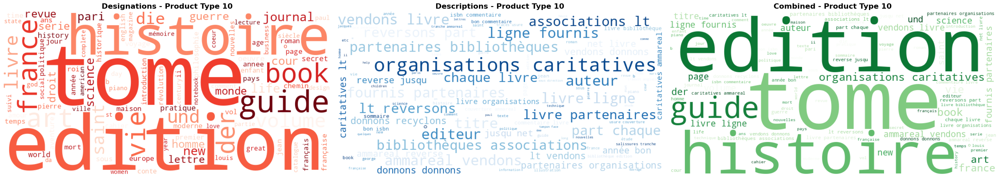

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,tome,156,livre,158,livre,204
1,edition,127,vendons,82,tome,168
2,guide,84,partenaires,82,edition,147
3,histoire,84,lt,82,histoire,98
4,france,60,donnons,82,guide,93
5,vie,55,ammareal,80,vendons,82
6,der,51,organisations,80,partenaires,82
7,art,50,caritatives,80,lt,82
8,book,47,bon,46,donnons,82
9,livre,46,année,45,organisations,81



📦 Sample Products for Product Type 10


,designation,description
19011,Analyses Factorielles Simples Et Multiples - O...,NaN
38665,Les Collines De L'est,NaN
15600,Magnétisme: Encyclopédie Magnétique Spirituali...,NaN
22220,Tom-Tom Et Nana Tome 29 - Toujours Plus Fort !,NaN
24948,Denholme And The Skeleton Puzzle,NaN
82127,Saint Coran Tajweed Avec Lecture Warsh Divisé ...,NaN
21327,Vichy Et Ses Environs. Guide De Poche Illustré...,NaN
62829,How To Be A Normal Person,NaN
15562,Abnormal Psychology Study Guide,NaN
44837,Contes D'irlande - L'ile Enchantée,NaN



📊 Stats for Product Type 10
Products: 3116
Unique designations: 3116
Unique descriptions: 332
Avg designation length: 57 characters
Avg description length: 255 characters




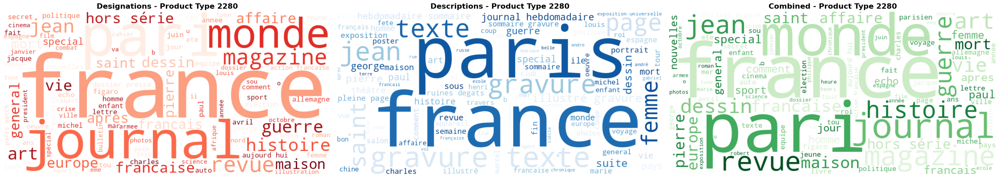

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,france,387,gravure,91,france,422
1,journal,333,texte,64,journal,350
2,paris,283,paris,37,paris,320
3,revue,256,france,35,revue,267
4,monde,219,sommaire,31,monde,230
5,magazine,205,illustré,28,magazine,210
6,vie,149,jean,26,jean,163
7,jean,137,page,19,vie,160
8,presse,125,saint,19,guerre,128
9,guerre,110,guerre,18,presse,126



📦 Sample Products for Product Type 2280


,designation,description
40625,J2 Journal Des Âmes Vaillantes Hugues Aufray 51,NaN
5733,Connaissance Des Arts N° 106 Du 01/12/1960 - L...,NaN
40842,Equipe (L') N° 18510 Du 27/02/2005 - Boxe - Ti...,NaN
8567,Maison Et Jardin N° 92 Du 01/04/1963 - Pour Le...,NaN
9741,Archeologia N° 82 Du 01/05/1975 - Grandiose Mu...,NaN
43194,Petit Journal (Le) N° 726 Du 26/01/1865 - La M...,NaN
73463,Time N° 42 Du 16/10/2011 - Tibet's Next Incarn...,NaN
77318,Today In English 274,NaN
26055,Radio Constructeur Et Depanneur 1948 45,NaN
48395,Edile Algerien (L') N° 155 Du 01/11/1961 - Dec...,NaN



📊 Stats for Product Type 2280
Products: 4760
Unique designations: 4753
Unique descriptions: 320
Avg designation length: 110 characters
Avg description length: 239 characters




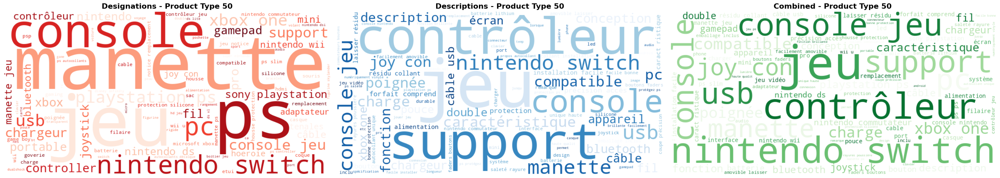

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,jeu,422,jeu,1514,jeu,1936
1,ps,374,console,663,ps,1036
2,nintendo,356,ps,662,nintendo,961
3,manette,246,nintendo,605,console,906
4,console,243,charge,600,charge,651
5,xbox,185,usb,506,usb,615
6,playstation,164,protection,417,protection,571
7,protection,154,haute,409,manette,554
8,switch,147,batterie,383,silicone,446
9,wii,116,facile,370,switch,439



📦 Sample Products for Product Type 50


,designation,description
81141,Hp Windows Mixed Reality Headset Vr1000-100nn ...,NaN
22549,Ii Controller Plus - Rose - Télécommande Wiimo...,"<p><span style=""font-family: arialhelveticasan..."
8876,Beats By Dre Beats Ecouteur Sans Fil Blanc,BEATS by Dre Beats Ecouteur sans Fil Blanc
1763,Nintendo - Gameboy Alarm Clock : P. Derive,NaN
46531,Sticker Sony Playstation Ps4 Slim Console Cont...,Sticker Sony Playstation PS4 SLIM Console Cont...
22508,Chargeur Allume Cigare Pour Micro Usb 1000mah ...,NaN
84276,Figurine Skylanders : Giants - Sprocket,NaN
66251,Remplacement De Bracelet De Bracelet De Bracel...,Mod¿¿le de camouflage Bracelet de remplacement...
82230,8bitdo Fc30 Manette Bluetooth Android/Ios/Pc,NaN
24236,Skin Manette Ps4 - Manchester,Skin Manette PS4 - Manchester



📊 Stats for Product Type 50
Products: 1681
Unique designations: 1633
Unique descriptions: 1078
Avg designation length: 69 characters
Avg description length: 661 characters




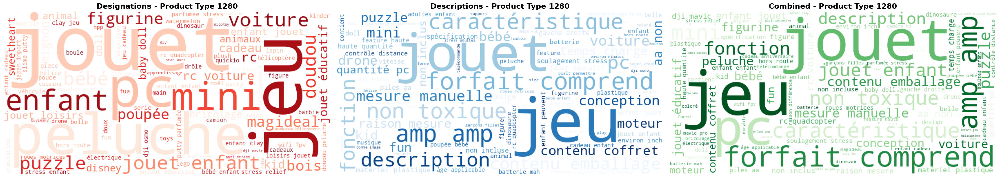

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,jouet,1349,enfant,4725,enfant,5782
1,enfant,1057,jouet,2962,jouet,4311
2,jeu,748,jeu,1963,jeu,2711
3,peluche,480,bébé,1742,bébé,2080
4,rc,475,haute,1691,haute,1741
5,doudou,435,batterie,1334,rc,1524
6,cadeau,348,matériel,1281,cadeau,1509
7,bébé,338,amp,1225,batterie,1391
8,puzzle,331,poupée,1161,poupée,1364
9,voiture,321,cadeau,1161,voiture,1311



📦 Sample Products for Product Type 1280


,designation,description
29053,Enfants Interactive Walking Glowing Dinosaur E...,Enfants Glowing Marche des dinosaures interact...
19386,Sg106 2.4ghz 4 Canaux Wifi Fpv Débit Optique D...,SG106 2.4Ghz 4 canaux WiFi FPV débit optique d...
20237,Madkanao Hélicoptère 449 Support De Protection...,Support de protection du fixateur de l&#39;hél...
48551,Black Girl Dolls African American Play Dolls L...,Black GirlDolls African American Play Dolls Li...
54926,Shopkins Série 4 Sacmimine 4-037,Shopkins série 4 Sacmimine 4-037.
6778,Hape - Cubes - Le Petit Prince - 10 Pièces,10 cubes à emboîter et à empiler avec les scèn...
33546,Jeu Jouet Bebe Eveil Tiny Love Electronique Chien,A partir de 6 mois<BR/>Un compagnon interactif...
23960,Assortiment De Roues Dentées Bois / Plastique ...,(Créez un double roue dentée en toute simplici...
68670,Jouet Enfants Éducation Magie Conseil De Peint...,Enfants Education Magic Painting Board Peintur...
38828,Grasp Puzzle Conseil Pour Enfants Puzzle Birth...,Casse-tête pour enfants Grasp Conseil Puzzle B...



📊 Stats for Product Type 1280
Products: 4870
Unique designations: 4809
Unique descriptions: 3695
Avg designation length: 73 characters
Avg description length: 806 characters




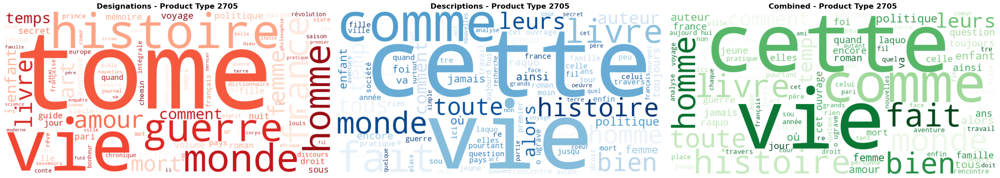

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,tome,204,cette,665,cette,667
1,vie,67,vie,598,vie,665
2,histoire,58,comme,532,comme,543
3,guerre,38,livre,476,livre,511
4,monde,38,bien,452,monde,465
5,france,37,monde,427,bien,461
6,livre,35,fait,416,fait,423
7,amour,34,re,378,histoire,412
8,comment,29,homme,357,homme,383
9,enfant,29,cet,355,re,379



📦 Sample Products for Product Type 2705


,designation,description
11052,La Philosophie D'auguste Comte,Auguste Comte est-il positiviste ? Du moins so...
84745,Le Folklore De France - La Faune,La fascination pour l'animal qu'il soit sauvag...
40731,Mort À Milano Centrale,Une nouvelle enquête étourdissante au bord du ...
84307,Le Petit Recueil De Poèmes,Avec douceur et légèreté sans réfléchir on se ...
16155,Naître À Cinquante Ans,Elle ne sait pas qui elle est. Elle n'a jamais...
25122,Les Compagnons De Maletaverne,Au 18e siècle dans les Cévennes les protestant...
9618,Un Secret Troublant - Coup De Foudre À La Clin...,Un secret troublant : Entre Phemie jeune urgen...
59967,Touchée Au C¿Ur (Vol. 3),NaN
10988,La Drogue 30 Ans Après,Myriam quinze ans vient avec sa mère qui a ent...
76744,Mettre En Oeuvre Le Programme De L'école Mater...,Cet ouvrage a pour objectif d?aider les enseig...



📊 Stats for Product Type 2705
Products: 2761
Unique designations: 2753
Unique descriptions: 1730
Avg designation length: 36 characters
Avg description length: 941 characters




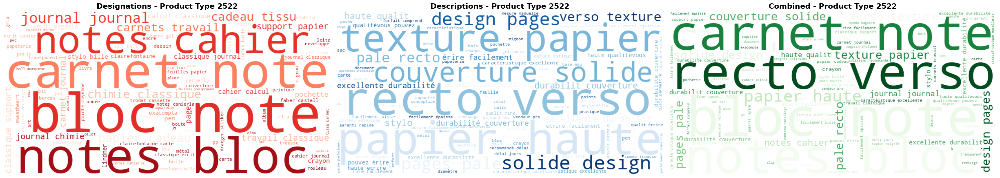

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,notes,1597,papier,1411,papier,1819
1,carnet,1047,haute,1113,notes,1719
2,journal,932,pages,1032,pages,1154
3,bloc,849,couverture,971,haute,1126
4,cahier,724,design,909,carnet,1102
5,classique,652,facilement,855,couverture,1014
6,papier,408,solide,848,journal,969
7,stylo,349,excellente,830,bloc,936
8,cadeau,278,texture,799,design,933
9,feuilles,270,verso,786,stylo,902



📦 Sample Products for Product Type 2522


,designation,description
32320,Sous-Main 40 X 53 Cm Noir,NaN
27292,Staedtler Lot De 6 Crayons De Couleur Ergosoft...,STAEDTLER Crayon de couleur ergosoft triangula...
29389,Menu Baptême / Communion Garçon Sur Une Plante,Lot de menus de baptême ou de communion représ...
19196,Carnet De Notes Bloc-Notes Cahier Voile Bleu O...,Taille: En format A5 (144 cm x 21 cm) Caractéi...
72557,Herma Protège-Cahier Schoolydoo A4 Polypro Ave...,Protège-cahier Schoolydoo A4 polypro avec etiq...
35356,Couleur Du Stylo Set Modèle Plastique Bloc-Not...,Couleur du stylo Set modèle plastique Bloc-not...
70516,Uniball Px20-N Paint Marker Marqueur Peinture ...,NaN
22280,Pack C Blanc - 100 X Enveloppes À Bulles 170x2...,NaN
24268,Carnet De Notes Bloc-Notes Cahier Pink Creamu ...,Taille: En format A5 (144 cm x 21 cm) Caracter...
72720,Bic Lot De 6 Tubes Colle Instantannée Liquide ...,Blister de 1 Tube Colle instantannée liquide F...



📊 Stats for Product Type 2522
Products: 4989
Unique designations: 4930
Unique descriptions: 2732
Avg designation length: 73 characters
Avg description length: 342 characters




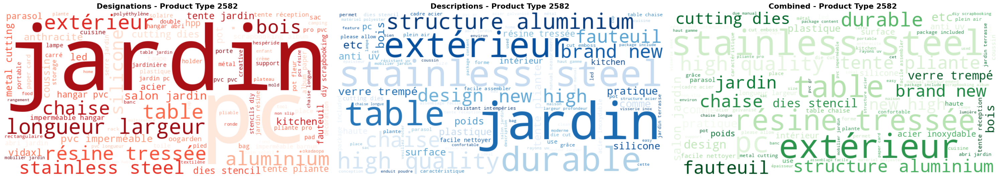

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,jardin,539,jardin,1383,jardin,1922
1,pvc,198,hauteur,1034,hauteur,1052
2,tente,187,facile,907,table,1034
3,table,186,aluminium,874,aluminium,990
4,kitchen,170,table,848,facile,908
5,extérieur,140,acier,803,acier,887
6,bois,140,polyester,653,bois,760
7,pcs,134,uv,637,tente,693
8,aluminium,116,résistant,629,extérieur,693
9,imperméable,116,bois,620,polyester,667



📦 Sample Products for Product Type 2582


,designation,description
39346,Carreaux En Wpc Rhone Aspect Bois Pour Balcon/...,Carreaux en WPC Rhone aspect bois pour balcon/...
38785,Pergola Autoportante Bois Douglas Toile Anthra...,Aspect : <br />Coloris : Anthracite (toile)<br...
84568,Stainless Steel Digital Electronic Kitchen Coo...,Stainless Steel DigitalElectronic Kitchen Cook...
13732,Barbecue À Bois Capri Coke Design Blive -,Barbecue à bois Capri Coke Design BLIVE - Barb...
23232,Tonnelle Autoportante Luchon 3 X 3 M Avec Ride...,La tonnelle autoportante LUCHON à l&#39;allure...
6264,Dokon Pour Table De Jardin Circulaire Imperméa...,Matériau durable - Fabriqué en tissu 420d Oxfo...
9822,Long Stainless Steel Ice Cream Cocktail Teaspo...,Long Stainless Steel Ice Cream Cocktail Teaspo...
51567,2 Cache-Pots Sur Pieds Design Stilt - Doré,Vos fleurs vont prendre de la hauteur avec ces...
69780,100 Clips Pour Lanière Largeur 50 Mm - Blanc,100 clips de fixation pour lanière pour paliss...
5614,Metal Die Cutting Dies Stencil For Diy Scrapbo...,Metal Die Cutting Dies Stencil For DIY Scrapbo...



📊 Stats for Product Type 2582
Products: 2589
Unique designations: 2502
Unique descriptions: 2309
Avg designation length: 73 characters
Avg description length: 880 characters




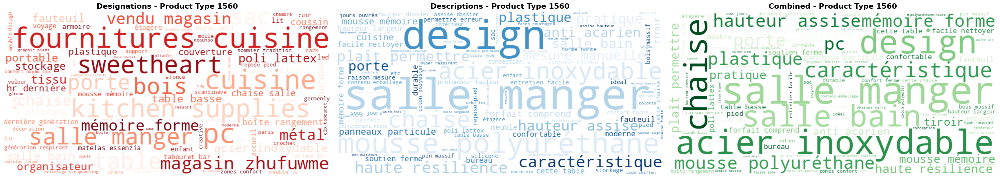

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,cuisine,609,hauteur,2619,matelas,3039
1,matelas,569,haute,2609,hauteur,2781
2,table,473,matelas,2470,haute,2691
3,bois,472,bois,2166,bois,2638
4,chaise,399,mousse,1965,table,2174
5,tissu,390,facile,1932,mousse,2172
6,rangement,348,assise,1787,tissu,2042
7,pcs,330,table,1701,facile,1944
8,salle,329,matériel,1677,design,1900
9,fournitures,280,tissu,1652,assise,1863



📦 Sample Products for Product Type 1560


,designation,description
28473,Matelas + Alèse 100x200 X 19 Cm Très Ferme - S...,MATELAS:<br />Â· Accueil : Ferme .<br />Â· Sou...
43414,2pc Clips Latéraux Pot En Acier Inoxydable Ant...,2PC Clips en acier inoxydable Pot Côté porte u...
505,Lot De 2 Matelas Latex Naturel 90x200 X 21 Cm ...,MATELAS:<br />Â· Accueil : Moelleux .<br />Â· ...
80546,Trixes Cadenas Noir À Combinaison 5 Lettres,TRIXES Cadenas Noir à Combinaison 5 Lettres Ut...
45086,Pill Medicine Box Holder Organisateur De Stock...,Pill Medicine Box Holder Organisateur de stock...
41106,"Boîte De Rangement Hello Kitty ""Ballerine"" 32x...",Livraison sous 10 à 30 jours ouvrés (Hors Week...
65954,Buyiesky®Maquillage Sequin Sac Réversible Sac ...,Maquillage Sequin Sac réversible Sac cosmétiqu...
32627,1 Pc Tortue Feuille Bois Plante Artificielle I...,1 Pc tortue Feuille Bois Plante artificielle i...
17266,Canapé Convertible Bz Hight 160cm Coton Noir S...,Le canapé BZ HIGHT est la solution de couchage...
45703,Système Solaire Céleste Comfort Flanelle Blank...,Système solaire céleste Comfort Flanelle Couve...



📊 Stats for Product Type 1560
Products: 5073
Unique designations: 4948
Unique descriptions: 4590
Avg designation length: 83 characters
Avg description length: 956 characters




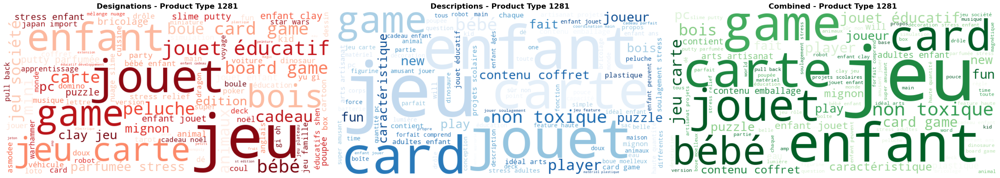

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,jeu,657,enfant,1962,enfant,2320
1,jouet,369,jeu,1282,jeu,1939
2,enfant,358,jouet,1059,jouet,1428
3,game,206,bébé,549,bébé,654
4,cartes,143,non,459,game,621
5,bois,113,cadeau,418,cadeau,529
6,cadeau,111,game,415,cartes,510
7,slime,107,haute,409,non,473
8,bébé,105,jouer,398,bois,469
9,stress,87,ans,383,jouer,431



📦 Sample Products for Product Type 1281


,designation,description
49317,Le Jeu Du Code De La Route - Version Voyage,NaN
3266,Star Wars Set Couverts Lightsaber Handles,A propos : - Contenu: 1x couteau 1x fourchette...
14386,Coffret Bois Laqué - 100 Jetons 115 Gr- 2 Jeux...,...
48512,Boum Jeu De Lettres Explosif,vintagele plus amusant des jeux de lettre
18090,Late For The Sky Boston-Opoly,pEnjoy this themed monopoly style game with a ...
79235,Jeu Des 7 Familles Hutchinson Classiques 2001,NaN
9783,Papier Puzzle Éducatif Développement Bébé Enfa...,Papier Puzzle éducatif développement bébé enfa...
72471,100 Pions Magnetique De Loto Orange + Ramasse ...,NaN
35985,Arthur Et Les Minimoys - Le Jeux De Cartes À L...,NaN
19473,Trivial Poursuit 20è Anniversaire,NaN



📊 Stats for Product Type 1281
Products: 2070
Unique designations: 2018
Unique descriptions: 1535
Avg designation length: 56 characters
Avg description length: 616 characters




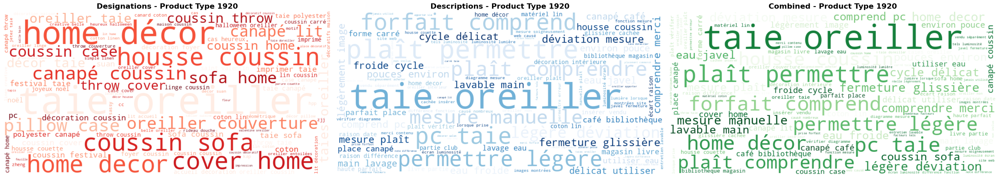

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,coussin,3081,oreiller,7411,oreiller,9377
1,taie,2204,taie,5710,taie,7914
2,oreiller,1966,coussin,4380,coussin,7461
3,home,1214,plaît,3505,canapé,3743
4,canapé,1102,matériel,2773,plaît,3506
5,décor,975,canapé,2641,matériel,2773
6,couverture,791,mesure,2408,coton,2701
7,sofa,670,coton,2069,décoration,2447
8,throw,655,haute,2019,home,2445
9,housse,652,lin,1994,mesure,2409



📦 Sample Products for Product Type 1920


,designation,description
5538,Crâne Parure De Couette Housse De Couette + Ta...,<ul><li>Crâne Parure de lit Housse de Couette ...
20148,Happy Valentine Oreiller Entoilées Coussin Sof...,Cas heureux Valentine oreiller Linge Coussin S...
16012,Store Roulant D'extérieur 120x230 Cm Rayures A...,<p>Créez un peu d&#39;intimité sur votre balco...
67508,Taie Sofa Taille Coussin Throw Cover Home Décor,Taie Canapé taille Throw Coussin Décoration in...
46374,Motif Jour De L'indépendance Ronde Cristal Vel...,Motif Jour de l&#39;Indépendance ronde cristal...
55053,One Piece Parure De Couette 3d Imprime-1 Houss...,<ul><li>1 Housse de Couette 220 x 230 cm &#43;...
44063,Betz Lot De 4 Serviettes Set De 2 Serviettes D...,<p>Betz Lot de 4 serviettes Set de 2 serviette...
40516,Etoile Céramique - Couleur - Dore Taille - 12,| Dimension : 12
62282,Kit De 2 Housse De Coussin Taie D'oreiller Ext...,<p><b>La description:</b></p><br /><p> Fabriqu...
57675,Lin Coton Vintage Taie Sofa Taille Coussin Thr...,Vintage Coton Lin Taie Sofa taille coussin Thr...



📊 Stats for Product Type 1920
Products: 4303
Unique designations: 3853
Unique descriptions: 3048
Avg designation length: 78 characters
Avg description length: 776 characters




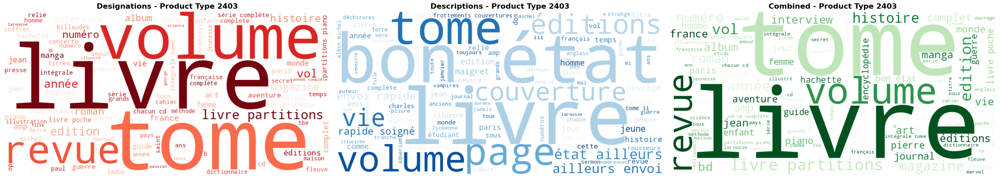

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,livre,949,état,40,livre,983
1,tomes,382,livre,34,tomes,389
2,volumes,313,bon,34,volumes,330
3,tome,285,éditions,18,tome,303
4,partitions,238,tome,18,partitions,238
5,revues,215,pages,18,revues,218
6,vol,169,volumes,17,vol,176
7,revue,158,ailleurs,16,histoire,165
8,histoire,156,soigné,15,revue,162
9,france,148,couvertures,15,france,155



📦 Sample Products for Product Type 2403


,designation,description
549,Lot 10 Volume Des Livre De Cuisine De A À Z,NaN
9908,Lot De 6 Romans Collection Nous Deux,NaN
83429,Vends Livre Rare De Collection : Oeuvres Chois...,NaN
56191,Bill Tornade Artima Album Relie N°154,NaN
70114,Claudette Fille Du Peuple,NaN
37976,Le Panorama De La Guerre 1914-1919-Les 76 Prem...,NaN
81421,Discours Et Messages Tome 2 : Dans L'attente -...,NaN
82022,Lot De 2 Revues Marklin Fevrier/Mars Avril/Mai...,NaN
8204,Victor Hugo : Chefs D&#39;Oeuvre Romanesques É...,NaN
44164,Lot 7 Numéros Electronique Applications1988 Co...,NaN



📊 Stats for Product Type 2403
Products: 4774
Unique designations: 4763
Unique descriptions: 126
Avg designation length: 68 characters
Avg description length: 223 characters




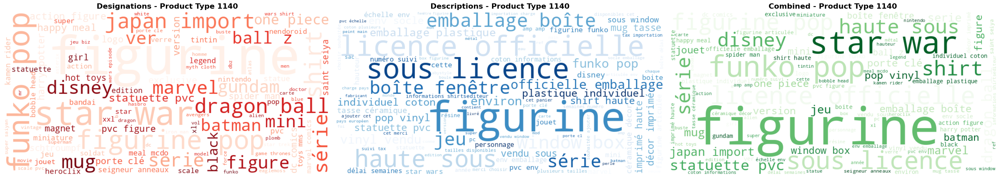

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,figurine,842,figurine,441,figurine,1283
1,pop,349,sous,201,pop,471
2,star,239,env,163,star,276
3,wars,218,officielle,154,wars,252
4,funko,177,licence,150,pvc,241
5,shirt,153,haute,143,funko,235
6,pvc,147,emballage,131,shirt,208
7,figure,131,pop,122,sous,204
8,marvel,121,boîte,116,figurines,180
9,dragon,102,pvc,94,officielle,164



📦 Sample Products for Product Type 1140


,designation,description
67378,Spider Man Homecoming Le Spiderman Q Version M...,Nom de marque: VSS Taille M Dimensions: ...
38557,Eléphant Roulant - Mcdonald&#39;S De 1989,NaN
46131,Japan Color Exclusive - Bumblebee - Takara Fir...,NaN
47785,Figurine Bugs Bunny - Monochrome Jaune,NaN
39313,Black Eyed Peas Magnet Dancing,Magnet en métal sous licence officielle Black ...
82925,Dc Comics Sac En Toile Batman,Sac en toile 100% polyester sous licence offic...
38520,Captain America - Peignoir Logo,NaN
6530,Nain Avec Trèfle Plastoy,NaN
65988,Lot De 7 Grandes Figurines Savane Jungle - 28 ...,Lot de 7 grandes figurines savane jungle - 28 ...
72344,Lot De 2 Figurines Indiens,NaN



📊 Stats for Product Type 1140
Products: 2671
Unique designations: 2670
Unique descriptions: 826
Avg designation length: 52 characters
Avg description length: 164 characters




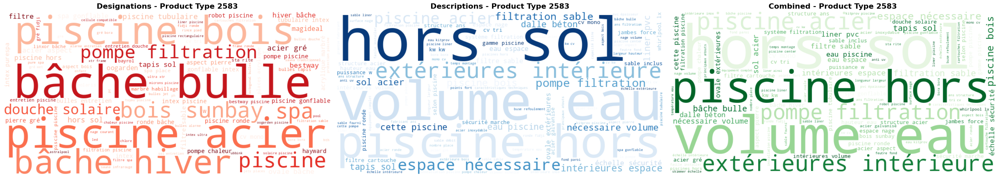

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,piscine,4674,piscine,18204,piscine,22878
1,bâche,1499,eau,10450,eau,10804
2,spa,1130,filtration,6118,filtration,6704
3,pompe,939,pompe,5554,pompe,6493
4,bulles,883,acier,5248,acier,5985
5,intex,830,sol,4415,sol,4925
6,acier,737,sable,3723,sable,4042
7,bois,712,hors,3507,hors,3771
8,ronde,700,liner,3249,bois,3708
9,gonflable,660,cv,3066,spa,3622



📦 Sample Products for Product Type 2583


,designation,description
42683,Kit piscine enterrée P-PSC rectangulaire haute...,NaN
19912,"HYDRA 1"" de Atlas - Filtres eau domestique",HYDRA 1&#34; de Atlas - Filtres eau domestique
78983,Kit piscine acier blanc Gré Bora Bora ronde 37...,Kit de piscine hors-sol ronde en acier Bora Bo...
72671,Pack Piscine autoportée Easy Set Intex 457 x 1...,Ce pack contient :- Piscine autoportée Easy Se...
75895,Film solaire de piscine ronde PE 250 cm Bleu,<p>Ce film solaire de piscine pose directement...
30302,Pompe de piscine Eurostar II - 18 m3/h Triphasé,Présentation de la pompe de filtration piscine...
4972,5 kg Chlore granulaire à dissolution lente dés...,<p><strong><em>Chlore granulaire</em></strong>...
48348,2pcs Clips Serviette en Plastique Pince à Ling...,<p><b>La description:</b></p><br /><ul><li> Mi...
12736,Corde de sécurité de séparation de piscine 6 m...,<p>Notre corde de séparation de sécurité pour ...
49783,INTEX Piscine Cars Enfant Gonflable 183 * 51 cm,NaN



📊 Stats for Product Type 2583
Products: 10209
Unique designations: 9717
Unique descriptions: 6775
Avg designation length: 58 characters
Avg description length: 789 characters




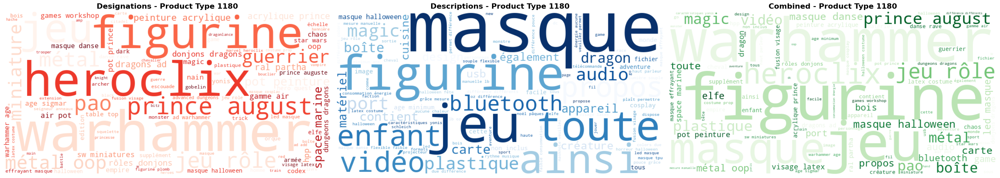

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,warhammer,121,masque,160,masque,221
1,jeu,88,halloween,98,jeu,142
2,heroclix,75,jeu,54,halloween,133
3,figurine,63,différence,43,warhammer,127
4,masque,61,led,38,figurine,87
5,prince,47,enfant,38,heroclix,75
6,métal,46,port,37,led,54
7,halloween,35,lumière,35,visage,51
8,august,35,latex,35,prince,48
9,oop,35,batterie,34,métal,48



📦 Sample Products for Product Type 1180


,designation,description
40236,Doctor Jeykll Deck By Us Playing Cards - Trick...,Doctor Jeykll Deck by US Playing Cards - Trick...
27962,Warhammer Aos - Stormcast Eternals Prosecutors,NaN
82734,L'art De Warhammer Online,NaN
20490,Mithril Prince August Orc Orque Guerrier,NaN
37518,Frodon Métal Communauté De L'anneau V1 Sda Lotr,NaN
65828,Star Strike 9011 Vessel Compendium #1,NaN
83387,Dungeoneer's Survival Guide Official Advanded ...,NaN
14789,Balais Pour Enfant En Kit,NaN
7936,Turning Point Stalingrad Wargame Avallon Hill,NaN
24096,Modules De Scénarios Tsr Douglas Niles And Tra...,NaN



📊 Stats for Product Type 1180
Products: 764
Unique designations: 764
Unique descriptions: 137
Avg designation length: 52 characters
Avg description length: 718 characters




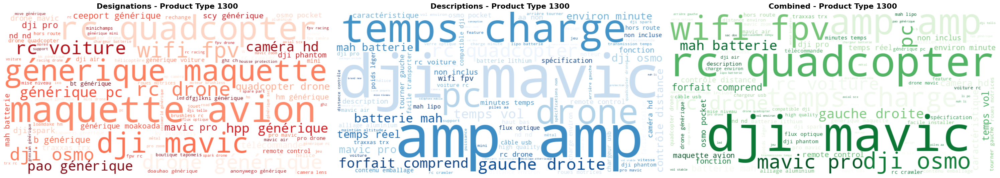

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,générique,3741,batterie,3845,rc,5672
1,rc,1894,rc,3778,drone,5133
2,drone,1659,drone,3474,batterie,4216
3,dji,1192,haute,2381,générique,3741
4,quadcopter,740,dji,2348,dji,3540
5,mavic,653,vol,2326,quadcopter,2523
6,voiture,592,temps,2186,haute,2467
7,fpv,553,distance,1857,vol,2375
8,avion,551,quadcopter,1783,mavic,2291
9,caméra,526,caméra,1760,caméra,2286



📦 Sample Products for Product Type 1300


,designation,description
58321,Zd5-G 24 Ghz 4ch 1080p 5mp Wifi Flux Optique D...,ZD5-G 24 GHz 4CH 1080P 5MP WIFI flux optique d...
66390,Support De Fixed Frame Imprimé Support Pour Dj...,Caméra Mont Holder Cadre support fixe imprimé ...
1030,Waterproof Decal Skins Wrap Autocollant De Pro...,Waterproof Decal Skins Wrap autocollant de pro...
42220,Wagon Transport De Caisses Electrotren Réf 110...,NaN
6729,F540 3000kv Étanche Brushless Et 45a Esc Pour ...,F540 3000KV Waterproof Brushless Motor&amp;45A...
2790,Maquette D'avion Remote Control Phone Flat Bra...,DajiangDJIimpérialPro mavicsoutien ZJ31noir
45271,Contrôleur De Vol 32 Bits Processeur Avec Étui...,<p>À propos du produit<br />1. 100% tout neuf ...
27920,Miniature Vaillante F1 1970 - Les Voitures De ...,NaN
5653,Pour Dji Air Drone Nd64 Mavic-Pl Appareil Phot...,Pour DJI Air Drone ND64 Mavic-PL Filtres Camer...
20300,Bateau Remote Control Rc 4ch Racing Étanche À ...,Bateau Remote Control RC 4CH Racing étanche à ...



📊 Stats for Product Type 1300
Products: 5045
Unique designations: 4988
Unique descriptions: 3631
Avg designation length: 92 characters
Avg description length: 997 characters




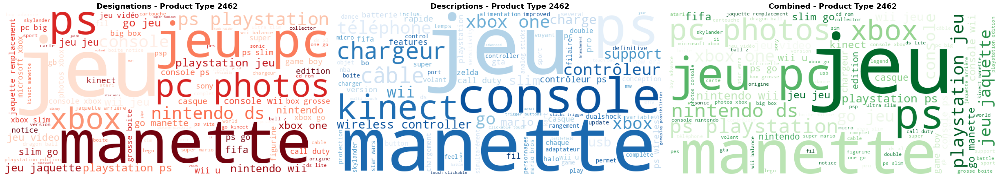

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,jeu,920,jeu,55,jeu,975
1,ps,368,ps,34,ps,402
2,xbox,260,manette,29,xbox,281
3,playstation,215,xbox,21,playstation,220
4,pc,214,console,19,pc,219
5,nintendo,192,manettes,17,wii,204
6,wii,191,kinect,14,nintendo,194
7,console,163,chargeur,14,console,182
8,go,152,wii,13,go,162
9,manettes,124,one,12,manettes,141



📦 Sample Products for Product Type 2462


,designation,description
3146,Steelbook Welcome To Suplex City,NaN
16874,Élément De Jeu - Jaquette De Remplacement - Te...,NaN
39834,Boite Video Sans Jeu - Lego Friends - Jeux Nin...,NaN
58447,Joystick Pour Ancienne Console Retro Joyball Msx,NaN
21332,Wii U + Manettes Jeux + Dysney Infinity 2.0 Et...,NaN
68681,Pack Ps1 Crash Ctr Console Et Jeu Tbe,NaN
33184,Lot - Street Boyz - Sur Ps2 - Playstation 2 &#...,NaN
31400,Spyro's Adventure Starter Pack + Hex + Zap + D...,NaN
34085,Xbox 360 + Kinect + 4 Jeux (Pes2013/Rayman Ori...,NaN
82657,Kingdom Hearts 2 Pal Promo,NaN



📊 Stats for Product Type 2462
Products: 1421
Unique designations: 1406
Unique descriptions: 53
Avg designation length: 52 characters
Avg description length: 264 characters




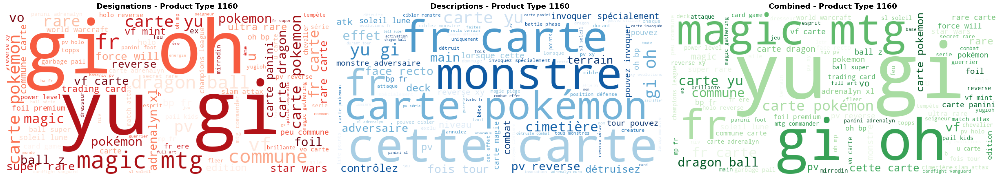

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,carte,1055,carte,420,carte,1475
1,fr,866,fr,246,fr,1112
2,yu,637,cette,152,yu,712
3,oh,626,monstre,143,oh,702
4,gi,624,pokémon,98,gi,699
5,vf,468,pouvez,93,vf,471
6,magic,465,pv,85,magic,465
7,mtg,444,oh,76,mtg,444
8,rare,377,yu,75,rare,381
9,commune,290,gi,75,pokémon,349



📦 Sample Products for Product Type 1160


,designation,description
73086,Rock Zurafa Rare_225/240_Carte Beyblade Vf Ser...,NaN
47077,Cornetale En Maraude - M14 - C,NaN
55274,Carte Dragon Ball Z Dp 224 Fr,NaN
1813,Pokémon - 101-R/131 - Bruyverne - Reverse,NaN
57272,Yu-Gi-Oh - Guaiba Préhistorique Ha03-Fr040 - S...,NaN
56175,Stego Noir En Francais 1 Ere Ed Potd-Fr019,NaN
47063,Pokemon Francaise Ex Legendes Oubliees Holo In...,NaN
58841,Carte Yu-Gi-Oh Pgl3-Fr066 Pléiades De La Const...,carte YU-GI-OH PGL3-FR066 Pléiades De La Const...
6159,Papilusion 3/147 Série Soleil Et Lune Ombres A...,NaN
27621,Roi Magni Bronzebeard - World Of Warcraft - He...,NaN



📊 Stats for Product Type 1160
Products: 3953
Unique designations: 3952
Unique descriptions: 342
Avg designation length: 54 characters
Avg description length: 135 characters




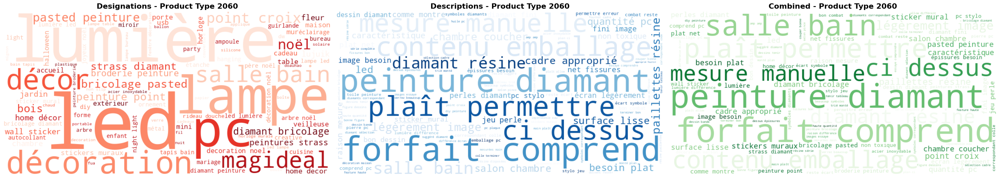

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,led,1146,lumière,3787,led,4341
1,noël,866,diamant,3698,lumière,4237
2,décoration,791,décoration,3220,diamant,4071
3,décor,726,led,3195,décoration,4011
4,lampe,717,peinture,2965,peinture,3441
5,bricolage,529,matériel,2463,noël,2903
6,peinture,476,pc,2462,lampe,2574
7,lumière,450,haute,2407,pc,2529
8,pcs,385,plaît,2393,matériel,2463
9,diamant,373,noël,2037,haute,2418



📦 Sample Products for Product Type 2060


,designation,description
53057,Kuopio Optique Suspension Verre 23x23x90 Cm Bleu,Suspension - Verre soufflé bouche - Bois natur...
52042,Dessin Animé Elsa Ann Réveil Princesse Sofia K...,Type:Réveils<br />Caractéristique:Luminova<br ...
10190,Statuette Retro 14x9x25.5 Cm Baigneuse Odile G...,NaN
68210,Multi-Fonction Télécommande Lumineuse Minuteri...,Nom de la marque:ISHOWTIENDA<br />Largeur:115 ...
16025,Blanc De Noël Chaud Fête De Mariage De Noël Dé...,Blanc chaud fête de mariage de Noël de Noël Dé...
13123,4pcs Creative Adhésif Plancher De Tuiles Stick...,4pcs Creative adhésif plancher de tuiles Stick...
65989,Wc Bidet Siège À Eau Spray Hygeian Eau Nettoye...,?Couleur blanche?Matériel principal: ABS?Fonct...
61409,"Ballon Bubble Étoiles Rose ""60"" 56 Cm 22"" Qual...",Ce <strong>ballon Bubble en plastique étirable...
23335,Paire Rideau Embrasses Ancien Porte Crochets R...,<p> Cette paire de embrasses ira bien avec n&#...
62122,Lutrin En Tissu Avec Tiroir,NaN



📊 Stats for Product Type 2060
Products: 4993
Unique designations: 4563
Unique descriptions: 4353
Avg designation length: 86 characters
Avg description length: 1074 characters




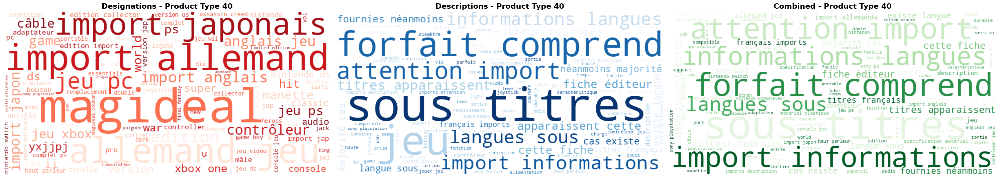

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,import,584,jeu,684,jeu,1146
1,jeu,462,sous,534,import,848
2,magideal,282,titres,508,sous,537
3,pc,237,comprend,324,titres,508
4,allemand,226,description,310,comprend,325
5,edition,194,cas,297,contrôleur,322
6,japonais,166,cette,290,description,310
7,ps,136,forfait,282,cas,307
8,xbox,110,contrôleur,272,pc,306
9,version,106,fiche,270,ps,306



📦 Sample Products for Product Type 40


,designation,description
71407,2weistein: Das Geheimnis Des Roten Drachen [Je...,NaN
2096,Ninja Gaiden Figurine Kureha 29 Cm,Chaque Beyblade se caractérise par des perform...
83818,50 Jeux Pour S'amuser,NaN
43647,Magideal Bouton D?Extension L2 R2 Trigger + Ca...,<p><b>La description:</b></p><br /><p> Pour la...
53837,5d's Trading Card Game Official Card Catalog T...,NaN
27679,Atv Offroad Fury 4 [Import Allemand] [Jeu Ps2],<br>Attention !!! Ce produit est un import si...
5477,Bard's Tale - Best Gamer,NaN
31584,Fort Boyard : Le Jeu - Edition Collector,NaN
33202,Nintendo Wii Mario Kart Selects (Sans Volant),...
28087,Simple Wii Series Vol.6: The Wai Wai Combat (I...,NaN



📊 Stats for Product Type 40
Products: 2508
Unique designations: 2480
Unique descriptions: 584
Avg designation length: 48 characters
Avg description length: 551 characters




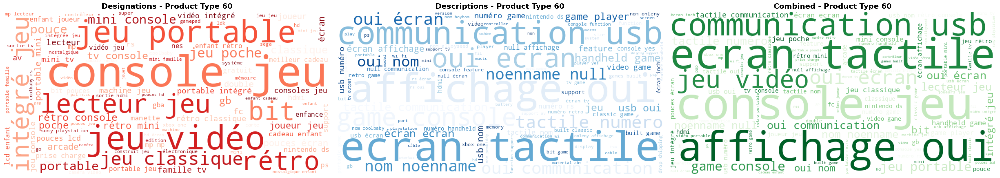

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,jeu,1780,oui,1136,jeu,1944
1,console,779,game,639,console,1206
2,portable,545,nom,623,oui,1136
3,vidéo,470,affichage,592,écran,701
4,rétro,418,tactile,584,game,659
5,mini,334,ecran,582,nom,623
6,pouces,292,écran,563,affichage,608
7,lecteur,277,numéro,560,portable,607
8,poche,236,usb,538,tactile,588
9,intégré,233,communication,536,ecran,582



📦 Sample Products for Product Type 60


,designation,description
62297,Manette De Jeu Rechargeable Sans Fil Pour Nint...,LARGE COMPATIBILITÉ: fonctionne avec la plupar...
83405,16 Gb Rs-97 Rétro Console De Jeu Portable Mini...,Numéro du modèle:Handheld Game Players<br />Af...
29554,Console De Jeu Mini Coolbaby Lecteur De Jeu De...,Nom de la marque:TECTINTER<br />Affichage de c...
57785,Mini Poche Console De Jeu Portable Rétro Jeu V...,Numéro du modèle:Pocket handheld game<br />Tai...
17606,4k Hd Mini Tv Video Game - Console De Jeu 800 ...,4K HD Mini TV Video Game Console console de je...
69383,Console De Jeu Pvp 3000 Jeux Avec Cartes De Je...,Numéro du modèle:pvp 3000<br />Taille de l&#39...
83304,Livraison Rapide Console De Jeu Portable 4.3 P...,Nom de la marque:NoEnName_Null<br />Affichage ...
9271,8 Bits Rétro Jeu Mini Classique Hdmi/Av Tv Con...,Numéro du modèle:821 game<br />Affichage de co...
26372,Sony Playstation 3 60 Go Starter Pack,NaN
56155,Console De Jeu Vidéo Prise En Charge De La Car...,Nom de la marque:ONLENY<br />Affichage de coul...



📊 Stats for Product Type 60
Products: 832
Unique designations: 775
Unique descriptions: 653
Avg designation length: 108 characters
Avg description length: 300 characters




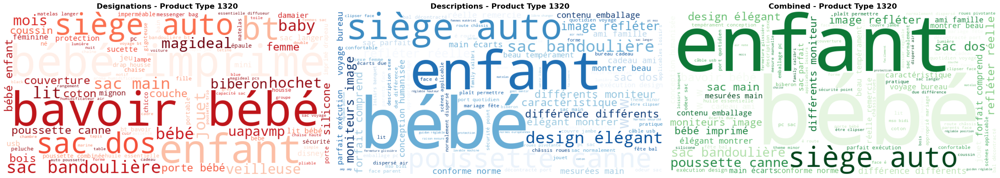

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,bébé,773,sac,1623,sac,2197
1,sac,574,bébé,1391,bébé,2164
2,bavoir,295,enfant,1123,enfant,1407
3,enfant,284,poussette,866,poussette,1099
4,bt,273,roues,729,sécurité,779
5,imprimé,236,sécurité,727,roues,762
6,poussette,233,réglable,646,siège,720
7,lit,195,mso,621,main,678
8,siège,155,w,600,réglable,663
9,auto,139,matériel,574,air,654



📦 Sample Products for Product Type 1320


,designation,description
60187,Humidificateur Filtre À Air Assainisseur Huile...,Humidificateur Filtre à air assainisseur Huile...
32295,Matelas Enfant Evolutif Anti-Acarien Et Antiba...,NaN
64909,Magideal Xylophone Glockenspiel Enfant Jouet 5...,<p><b>La description:</b></p><br /><p> Coloré ...
8307,Mode Féminine Couleur Unie Épaule Sac À Dos Sa...,Mode féminine Couleur unie épaule Sac à dos éc...
74403,Nouveau-Né Bébé Tricot Amovible Et Lavable Por...,Nouveau-né bébé tricot portable amovible et la...
26454,Magideal Jouet De Traction Jouet À Tirer Compa...,<p><b>La description:</b></p><br /><p> 100% ne...
33914,Sanetta - Robe - Mixte Bébé - Blanc Weiss - Na...,Modèle : 302200 Référence fabricant : 302200 T...
30654,Bavoir Bébé Imprimé Grande Roue England Blanc,NaN
33219,Paw Patrol Rehausseur Dossier R Way - Rose,PAW PATROL Rehausseur dossier R Way - Rose - R...
55342,Tineo Matelas Impermeable - Coutil Absorbant -...,TINEO Matelas impermeable - Coutil absorbant -...



📊 Stats for Product Type 1320
Products: 3241
Unique designations: 3197
Unique descriptions: 2022
Avg designation length: 61 characters
Avg description length: 756 characters




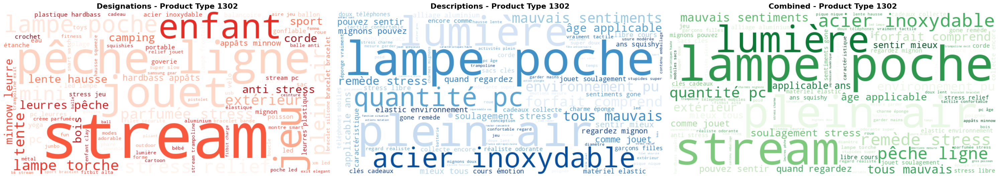

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,stream,779,enfant,1197,enfant,1454
1,pêche,447,jouet,1069,pêche,1447
2,jouet,314,pêche,1000,jouet,1383
3,jeu,299,haute,973,stress,1127
4,lampe,280,comme,903,jeu,999
5,stress,259,stress,868,haute,985
6,enfant,257,matériel,836,comme,903
7,led,230,facile,722,lampe,876
8,ligne,228,eau,719,matériel,842
9,bracelet,210,jeu,700,pc,807



📦 Sample Products for Product Type 1302


,designation,description
74340,Protable Sport Bouteille D'eau Avec De La Pail...,Protable Sport Bouteille d&#39;eau avec de la ...
70676,Tongs The Paw Patrol 9237 (Taille 27),L&#39;amusement est assuré pour l&#39;été avec...
47087,Luxe Montre En Silicone Bracelet Bande Pour Sa...,Luxe Montre en silicone Bracelet bande pour Sa...
72394,Lampe De Poche Tactique Xm-L T6 Led Zoomables ...,Torche tactique XM-L T6 lampe LED zoomables to...
34961,Vous Avez Manqué La Corde Téléscopique Poisson...,Vous avez manqué la corde téléscopique poisson...
84235,Remplacement Bracelet En Cuir Véritable Bracel...,Remplacement de luxe bracelet en cuir véritabl...
76538,Intex Matelas Gonflable Enfant Baleine A Cheva...,Marque : INTEX Dimensions : Longueur 163 cm Ag...
27360,Nerf Dart Tag Quick 16,NaN
28906,Set 20pcs Crankbaits Pêche Leurre Poisson Croc...,Set 20PCS Crankbaits Pêche Leurre poisson Croc...
76074,11pcs Bandes De Résistance Ensemble Expander C...,11pcs bandes de résistance Ensemble Expander É...



📊 Stats for Product Type 1302
Products: 2491
Unique designations: 2307
Unique descriptions: 1995
Avg designation length: 73 characters
Avg description length: 820 characters




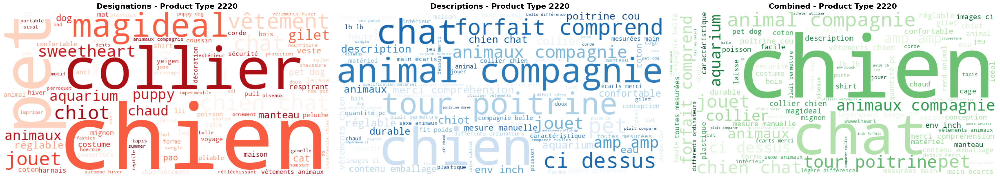

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,chien,389,chien,889,chien,1278
1,pet,231,animaux,473,pet,658
2,chat,194,animal,434,animaux,575
3,vêtements,139,pet,427,chat,476
4,collier,106,compagnie,421,vêtements,471
5,dog,105,matériel,334,animal,465
6,animaux,102,vêtements,332,compagnie,447
7,magideal,98,longueur,313,chiens,354
8,jouet,78,chiens,284,matériel,337
9,chiens,70,chat,282,collier,319



📦 Sample Products for Product Type 2220


,designation,description
62701,New Pet Image En Noir Et Blanc Jupe Grille D'a...,New Pet Image en noir et blanc Grille Jupe aut...
17367,3 En 1masseur Toilettage Pour Chats Arche De M...,<p><b>La description:</b></p><br /><p> Multi-u...
6939,Chien Pet Chaud Veste En Coton Vêtements D'hiv...,Chien Pet vêtements chauds d&#39;hiver Mode Co...
16985,Arbre À Chat Et Griffoir Sisal 150 Cm Empreint...,Offrez à vos amis félins un avant-goût du luxe...
29102,Green Water Manteau Imperméable Pour Chien Ves...,<br />Assurez-vous que votre animal soit attra...
34954,Pur Cataire Naturel Pet Cat Molar Dentifrice B...,Pur naturel cataire Pet Cat Molar Dentifrice b...
83582,Luckypet Arbre À Chat Griffoir Bleu Claire Bei...,Cet arbre à chat offre à votre petit félin l'e...
9168,Dental Sticks - Lot De 5,Dental sticks
69934,Pet Dog Chaussettes Chaussettes Mignon Chaud P...,Chien Chaussettes mignon chaussettes chaudes p...
74954,Arbre À Chat En Sisal Montage Mural 194 Cm Bei...,<p>Avec cet arbre à chat de haute qualité à mo...



📊 Stats for Product Type 2220
Products: 824
Unique designations: 817
Unique descriptions: 748
Avg designation length: 75 characters
Avg description length: 815 characters




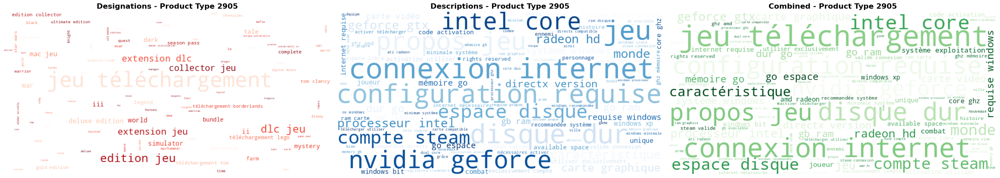

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,jeu,867,jeu,2282,jeu,3149
1,téléchargement,866,windows,2105,windows,2105
2,edition,105,gb,1417,gb,1417
3,extension,101,carte,1326,carte,1326
4,dlc,72,directx,1266,directx,1266
5,collector,47,go,1254,go,1254
6,deluxe,33,ghz,1225,ghz,1225
7,ii,19,disque,1146,disque,1146
8,mac,19,système,1138,système,1138
9,war,18,mémoire,1120,mémoire,1121



📦 Sample Products for Product Type 2905


,designation,description
76621,Mount & Blade - Jeu En Téléchargement,<div> <p><strong>Note :</strong> code d&#39;ac...
28858,Mosaïque Pirate Trésors Des Caraïbes - Jeu En ...,<p>Pirate Mosaic Puzzle - Caribbean Treasures ...
35214,Lunar Flight - Jeu En Téléchargement,NOTE : Jeu en anglais. Code d&#39;activation à...
74970,Pac-Man Museum? - Jeu En Téléchargement,NOTE : code d&#39;activation à utiliser exclus...
39838,Disney Fairies : Les Aventures De La Fée Cloch...,NOTE : code d&#39;activation à utiliser exclu...
29571,Melty Blood Actress Again Current Code - Jeu E...,The final episode of the series &#39;MELTY BLO...
77849,Enchanted Kingdom: Mauvaise Graine Édition Col...,<p>La sélection des éditeurs ! Ce jeu a été ch...
13773,Le Mystère De La Base Lunaire - Jeu En Télécha...,Accident ? Sabotage ? Les Débrouillards parten...
65379,Hellforces - Jeu En Téléchargement,Développeur : Orion<br /> Genre : FPS<br /> Da...
78554,Panzer Panic Vr - Jeu En Téléchargement,<div> <p><strong>NOTE :</strong> Un compte Ste...



📊 Stats for Product Type 2905
Products: 872
Unique designations: 872
Unique descriptions: 872
Avg designation length: 54 characters
Avg description length: 2652 characters




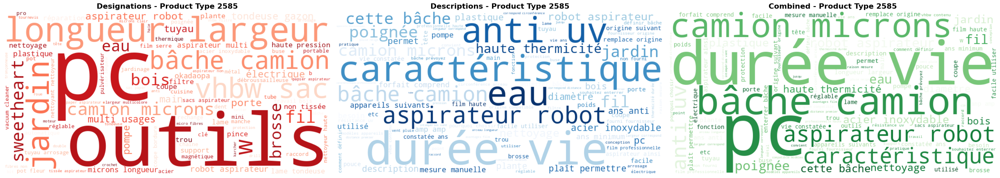

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,aspirateur,269,bâche,1394,bâche,1499
1,outils,181,haute,1157,aspirateur,1271
2,longueur,170,aspirateur,1002,haute,1209
3,largeur,164,eau,952,eau,1044
4,jardin,161,facile,780,facile,784
5,pcs,151,caractéristiques,732,film,765
6,microns,145,film,711,caractéristiques,732
7,tondeuse,135,plastique,611,longueur,711
8,vhbw,133,acier,591,plastique,675
9,arrosage,115,matériel,590,largeur,670



📦 Sample Products for Product Type 2585


,designation,description
77875,Brosse anti-poussière en plastique Câble Plaqu...,Description: <br />Cette plaque murale brosse ...
63097,Relais LCD Commutateur hebdomadaire programmab...,Relais LCD Commutateur hebdomadaire programmab...
30618,Seagrass panier en osier Pot de fleurs Panier ...,Seagrass panier en osier Pot de fleurs pliant ...
79801,Bâche de bassin 350 microns noir - Longueur : ...,Cette bâche de bassin en 350 microns noir est ...
42548,vhbw 10 Sacs d&#39;aspirateur en papier pour a...,<br /> Le sac d&#39;aspirateur compatible et é...
1804,ustensiles de cuisine en silicone haute tempér...,ustensiles de cuisine en silicone haute tempér...
71944,Piètement roulant DEWALT pour scie à table DW7...,<u>Détails :</u> <ul><li>Les roulettes de gran...
27096,Honeycomb cire d'abeille Fondation Ruche Cire ...,Honeycomb cire d&#39;abeille Fondation Ruche d...
27594,vhbw 5 sacs micro fibres non tiss?es pour aspi...,<b>Sacs pour aspirateur en micro fibres non ti...
30627,Kärcher Préfiltre de pompe petite taille - 2.9...,<ul><li>Filtre amovible - Le filtre peut être ...



📊 Stats for Product Type 2585
Products: 2496
Unique designations: 2428
Unique descriptions: 2076
Avg designation length: 75 characters
Avg description length: 962 characters




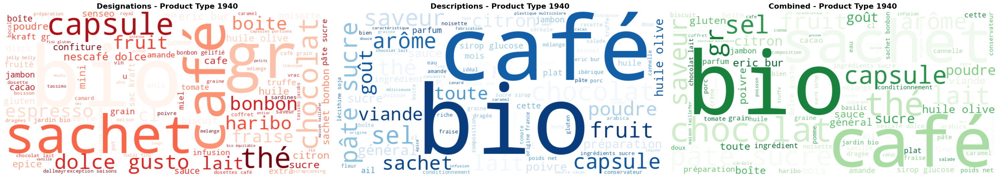

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,bio,144,bio,243,bio,387
1,café,71,sucre,238,sucre,266
2,gr,70,café,189,café,260
3,chocolat,54,lait,158,chocolat,189
4,capsules,53,chocolat,135,lait,186
5,sachet,51,sachet,130,sachet,181
6,thé,43,poudre,121,huile,151
7,huile,32,pâte,121,poudre,137
8,sucre,28,ingrédients,119,pâte,135
9,lait,28,huile,119,gr,129



📦 Sample Products for Product Type 1940


,designation,description
21925,Mélange Fruité Raisins Noisettes Baies De Goji...,mix apéritif sans sel sachet refermable<br />i...
34519,Germalyne Tradition 250g Abbaye De Sept Fons,NaN
18952,Jacobs Dosettes De Café Crema Équilibré Goût V...,La composition unique de grains décaféinés et ...
57721,Truffe Brossée Extra 1 U - Verrine 70ml 12.5g,<br />
59166,Carambar Bonbons Caragourmand. Parfums - Vanil...,CARAMBAR Bonbons Caragourmand. parfums - vanil...
84140,Tiptree Confiture Cassis 340g Bio,TIPTREE Confiture Cassis 340g Bio - TIPTREE Co...
64104,Jambon Tranché Gran Reserva - 10 Enveloppes / ...,Jambon Tranché Gran Reserva - 3 ENVELOPPES de ...
37741,Tassimo Twinings Thé Vert 40g X5,NaN
25057,Olives À La Farce De Piment D'espelette Ederki...,<br />
46685,Tassimo Jacobs Caffè Crema Doux & Velouté Rain...,Tassimo Jacobs Caffè Crema Doux &amp; Velouté ...



📊 Stats for Product Type 1940
Products: 803
Unique designations: 802
Unique descriptions: 670
Avg designation length: 50 characters
Avg description length: 337 characters




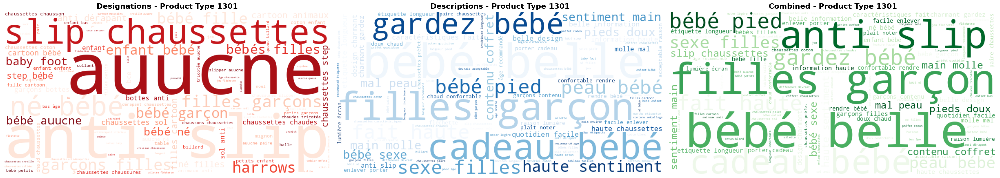

,Word (Designation),Frequency,Word (Description),Frequency,Word (Combined),Frequency
0,chaussettes,490,bébé,1626,bébé,2034
1,bébé,408,chaussettes,1024,chaussettes,1514
2,auucne,382,longueur,839,longueur,839
3,enfant,275,haute,570,filles,705
4,filles,248,filles,457,enfant,675
5,cartoon,207,belle,444,haute,572
6,garçons,194,coton,422,garçons,569
7,anti,185,enfant,400,coton,527
8,né,147,âge,390,cartoon,444
9,slip,126,garçons,375,belle,444



📦 Sample Products for Product Type 1301


,designation,description
73549,Enfants Bébés filles Chaussette de coton Migno...,Bébé Enfant Fille confortable dentelle Chausse...
32045,Mignon Enfants Coton bébé dentelle filles enfa...,Dentelle Coton mignon bébé enfants filles enfa...
25158,XQmax Fléchettes MvG Green Demolisher 25g 70% ...,Le set de fléchettes de 25 g Green Demolisher ...
36087,Tout-petits peignés coton socquettes Bébés fil...,Tout-petits peigné Chaussettes cheville coton ...
58071,Queue Billard Dufferin Mosiac2 (1/2)-Dufferin,Longueur : 145 cm. Jonction : 1/2 en acier ino...
83317,Décapsuleur Baby Foot Bleu-Supreme,Décapsuleur Baby Foot Bleu.En aluminium.Dimens...
22236,Marathon lot de 9 ailettes de fléchettes 1524-...,<p>Des ailettes de fléchettes résistantes et r...
26928,Tout-petits enfants filles Stripe Dot Big Eyes...,Enfant en bas âge Enfants Filles Stripe Dot Bi...
49591,Nouveau-né Bébé Garçons Filles Cartoon animaux...,Nouveau-né Bébé Garçons Filles Cartoon animal ...
61571,Nouveau-né bébé élastique à rayures solides co...,Nouveau-né bébé élastique à rayures solides co...



📊 Stats for Product Type 1301
Products: 807
Unique designations: 595
Unique descriptions: 554
Avg designation length: 75 characters
Avg description length: 583 characters




In [7]:
# Download French stopwords
nltk.download('stopwords')

# Load French stopwords and add custom ones
french_stopwords = set(stopwords.words('french'))
custom_stopwords = {
    # Balises et éléments HTML/CSS courants
    'br', 'nbsp', 'quot', 'http', 'https', 'www', 'img', 'src', 'alt',
    'div', 'span', 'style', 'class', 'border', 'font', 'color',

    # Descriptions and measures
    'voir', 'photo', 'plus', 'cm', 'mm', 'kg', 'ml', 'x', 'l', 'm', 's',
    'taille', 'produit', 'prix', 'offre', 'détails', 'neuf', 'garantie',
    'qualite', 'qualité', 'sans', 'type', 'chez', 'être', 'tout', 'dont',
    'assez', 'dimension', 'dimensions', 'format', 'etat', 'lot', 'paquet', 'pack',
    'modèle', 'marque', 'couleur', 'couleurs', 'matière', 'matériau', 'matériaux',
    'usage', 'utilisation', 'occasion', 'vente', 'commerce', 'collection', 'édition',

    # COlors courantes en français
    'blanc', 'blanche', 'noir', 'noire', 'rouge', 'bleu', 'bleue', 'vert', 'verte', 'jaune',
    'gris', 'grise', 'orange', 'rose', 'marron', 'violet', 'violette', 'turquoise', 'beige',
    'argent', 'doré', 'dorée', 'or', 'cuivre', 'cyan', 'indigo', 'lavande', 'saumon', 'bordeaux',

    # Common english words
    'the', 'of', 'or', 'a', 'agrave', 'and', 'in', 'to', 'for', 'i', 'is', 'it', 'on',
    'with', 'this', 'that', 'by', 'from', 'as', 'at', 'an', 'be', 'are',

    # Mots isolés ou symboles, ponctuation
    'gt', 'p', 'e', 'eacute', 'egrave', 'ecirc', 'g', 'f', 'r', 'v', 'si', 'aussi',
    'h', 'â', 'très', 'peut', 'rsquo', 'd\'', 'l\'', 'qu\'', 'j\'', 'n\'',

    # Adjectifves and adverbs
    'grand', 'grande', 'petit', 'petite', 'même', 'autre', 'autres', 'ancien', 'ancienne',
    'nouveau', 'nouvelle', 'possible', 'certain', 'seul', 'seule', 'différent', 'différente',

    # Verbs and auxiliaries
    'avoir', 'être', 'faire', 'pouvoir', 'aller', 'venir', 'devoir', 'prendre', 'mettre',
    'dire', 'vouloir', 'savoir', 'falloir', 'voir', 'demander', 'trouver', 'donner',

    # Common ecommerce terms
    'livraison', 'service', 'client', 'qualité', 'offert', 'offrir', 'occasion', 'garantie',
    'retour', 'facture', 'commande', 'référence', 'stock', 'disponible', 'promo', 'promotion',
    'échange', 'reprise', 'remise', 'prix', 'paiement', 'mode', 'de', 'à',

    # Short connectors courtes et connecteurs
    'et', 'ou', 'mais', 'donc', 'or', 'ni', 'car', 'par', 'pour', 'sur', 'sans', 'avec',
    'dans', 'entre', 'chez', 'vers', 'contre', 'depuis', 'avant', 'après', 'pendant',

    # Letter numbers
    'un', 'une', 'deux', 'trois', 'quatre', 'cinq', 'six', 'sept', 'huit', 'neuf', 'dix',

    # Noms génériques et trop fréquents en ecommerce
    'accessoire', 'accessoires', 'outil', 'outils', 'élément', 'éléments', 'pièce', 'pièces',
    'article', 'articles', 'ensemble', 'ensembles', 'set', 'kits', 'kit'
}

all_stopwords = french_stopwords.union(custom_stopwords)

# Define your word grouping dictionary (lemmatization-like rules)
word_grouping = {
    'livres': 'livre',
    'jeux': 'jeu',
    'toy':'jeu',
    'jouets':'jouet',
    'enfants':'enfant',
    'agrave': 'a',
    'eacute': 'e',
    'egrave': 'e',
    'ecirc': 'e',
    'gravures': 'gravure',
    'car':'voiture',
    'tools': 'outils'
}

# Clean and tokenize text with word grouping applied
def clean_text(text):
    if not isinstance(text, str):
        return []
    text = text.lower()
    text = re.sub(r'<[^>]+>', ' ', text)  # Remove HTML tags
    text = re.sub(r'[^a-zàâçéèêëîïôûùüÿñæœ\s]', ' ', text)  # Keep only letters and spaces
    text = re.sub(r'\s+', ' ', text).strip()  # Normalize whitespace

    tokens = text.split()
    # Remove stopwords and apply grouping
    cleaned_tokens = []
    for w in tokens:
        if w not in all_stopwords:
            # Map to grouped form if exists
            if w in word_grouping:
                cleaned_tokens.append(word_grouping[w])
            else:
                cleaned_tokens.append(w)
    return cleaned_tokens

# Get product types
product_types = X_train['prdtypecode'].unique()

for prd_type in product_types:
    type_data = X_train[X_train['prdtypecode'] == prd_type]

    designation_tokens = type_data['designation'].dropna().astype(str).apply(clean_text).sum()
    description_tokens = type_data['description'].dropna().astype(str).apply(clean_text).sum()

    designation_text = ' '.join(designation_tokens)
    description_text = ' '.join(description_tokens)
    combined_tokens = designation_tokens + description_tokens
    combined_text = ' '.join(combined_tokens)

    # Create word clouds
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 8))

    if designation_text:
        wc1 = WordCloud(width=800, height=400, background_color='white',
                        colormap='Reds', max_words=100).generate(designation_text)
        ax1.imshow(wc1, interpolation='bilinear')
        ax1.set_title(f'Designations - Product Type {prd_type}', fontsize=16, fontweight='bold')
        ax1.axis('off')
    else:
        ax1.text(0.5, 0.5, 'No designation data', ha='center', va='center', transform=ax1.transAxes)
        ax1.axis('off')

    if description_text:
        wc2 = WordCloud(width=800, height=400, background_color='white',
                        colormap='Blues', max_words=100).generate(description_text)
        ax2.imshow(wc2, interpolation='bilinear')
        ax2.set_title(f'Descriptions - Product Type {prd_type}', fontsize=16, fontweight='bold')
        ax2.axis('off')
    else:
        ax2.text(0.5, 0.5, 'No description data', ha='center', va='center', transform=ax2.transAxes)
        ax2.axis('off')

    if combined_text:
        wc3 = WordCloud(width=800, height=400, background_color='white',
                        colormap='Greens', max_words=100).generate(combined_text)
        ax3.imshow(wc3, interpolation='bilinear')
        ax3.set_title(f'Combined - Product Type {prd_type}', fontsize=16, fontweight='bold')
        ax3.axis('off')
    else:
        ax3.text(0.5, 0.5, 'No combined data', ha='center', va='center', transform=ax3.transAxes)
        ax3.axis('off')

    plt.tight_layout()
    plt.show()

    # Frequency counts separately
    designation_counts = Counter(designation_tokens)
    description_counts = Counter(description_tokens)
    combined_counts = Counter(combined_tokens)

    top_designation = designation_counts.most_common(20)
    top_description = description_counts.most_common(20)
    top_combined = combined_counts.most_common(20)

    df_designation = pd.DataFrame(top_designation, columns=['Word (Designation)', 'Frequency'])
    df_description = pd.DataFrame(top_description, columns=['Word (Description)', 'Frequency'])
    df_combined = pd.DataFrame(top_combined, columns=['Word (Combined)', 'Frequency'])

    # Display top 20 words side-by-side
    display(HTML(f"<h3>Top 20 Words for Product Type {prd_type}</h3>"))
    display(pd.concat([df_designation, df_description, df_combined], axis=1))

    # Print 10 product samples
    print(f"\n📦 Sample Products for Product Type {prd_type}")
    print("=" * 60)
    display(type_data[['designation', 'description']].sample(min(10, len(type_data)), random_state=42))

    # Other stats
    print(f"\n📊 Stats for Product Type {prd_type}")
    print("=" * 60)
    print(f"Products: {len(type_data)}")
    print(f"Unique designations: {type_data['designation'].nunique()}")
    print(f"Unique descriptions: {type_data['description'].nunique()}")
    print(f"Avg designation length: {type_data['designation'].str.len().mean():.0f} characters")
    print(f"Avg description length: {type_data['description'].str.len().mean():.0f} characters")
    print("\n" + "=" * 60 + "\n")


## Defining the product types

In [8]:
print('''Based on the observation of the word frequencies and wordclouds, we are in capacity to define the product types associated to each code''')

prdtypes = {
    10: "Livres d'occasion",
    40: "Jeux vidéo",
    50: "Accessoires de jeux vidéo",
    60: "Consoles de jeux vidéo",
    1140: "Figurines Enfant",
    1160: "Cartes à Collectionner",
    1180: "Figurines Adulte et Jeux de role",
    1280: "Jouets",
    1281: "Jeux de société",
    1300: "Jouets télécommandés",
    1301: "Chaussettes bébé",
    1302: "Pêche Enfant",
    1320: "Puériculture",
    1560: "Mobilier intérieur",
    1920: "Literie",
    1940: "Alimentation",
    2060: "Décoration",
    2220: "Animaux",
    2280: "Revues et Magazines",
    2403: "Lots Magazines, Livres et BDs",
    2462: "Jeux d'occasion",
    2522: "Papeterie",
    2582: "Mobilier de jardin",
    2583: "Equipement de piscine",
    2585: "Entretien",
    2705: "Livres neufs",
    2905: "Jeux PC"
}

#Adding prdtypes to our dataframes
Y_train["prdtype"] = Y_train["prdtypecode"].map(prdtypes)
X_train["prdtype"] = X_train["prdtypecode"].map(prdtypes)
display(X_train.sample(10).sort_values(by="prdtypecode"))

Based on the observation of the word frequencies and wordclouds, we are in capacity to define the product types associated to each code


,designation,description,productid,imageid,prdtypecode,prdtype
59195,Fifa Soccer 10 World Class Soccer[Import Japon...,NaN,138460642,891727196,40,Jeux vidéo
62591,Protège Matelas Imperméable 2x80x210 Antony Sp...,<p>Alèse imperméable 2x80x210 cm forme drap ho...,2014632767,1120576589,1920,Literie
67306,Simple Linen Creative Belle Oreiller Taie D'or...,Simple Linen Creative Belle taie d&#39;oreille...,4231823186,1323353524,1920,Literie
61773,Joyeux Noël Linen Pillow Cases Coussin Sofa Dé...,Joyeux Noël Linen Pillow Cases Coussin Sofa Ac...,3887598041,1258999497,1920,Literie
66951,Nouveau Romantique Bowknot Etoffe De Soie Céré...,Nouveau romantique bowknot Etoffe de soie Céré...,3880038607,1257284400,2060,Décoration
40060,Asatte Dance Intégrale Tomes 1 À 7 Première Éd...,NaN,1589145099,1092794802,2403,"Lots Magazines, Livres et BDs"
58318,Wii Noire + 4 Jeux + Nunchuk + 2 Volants + 2 M...,NaN,3619524956,1228676959,2462,Jeux d'occasion
61045,Spa 3 places Caprice - Acrylique Noir Marbré -...,Dimensions : 196 x 131 x 83 cm //// Nombre et ...,2695198405,1158121345,2583,Equipement de piscine
14922,Pack Nettoyant de ligne d'eau Protect & Clean ...,Ce pack Bayrol permet de nettoyer efficacement...,3958959529,1269455611,2583,Equipement de piscine
18364,Poêle Sound platinium de 45 kW à 8 kW,Poêle électrique Sound <p>Les <strong>poêles ...,4182657223,1310068930,2583,Equipement de piscine


## Distribution of products across product types

In [9]:
### 1. General statistics ###

# Standard statistics
prdtypecode_count = X_train['prdtypecode'].value_counts()

prdtypecode_max_frequency = prdtypecode_count.idxmax()
prdtypecode_min_frequency = prdtypecode_count.idxmin()
prdtypecode_avg_frequency = round(prdtypecode_count.mean(), 0)
prdtypecode_med_frequency = round(prdtypecode_count.median(), 0)
prdtypecode_std_classes = round(prdtypecode_count.std(), 0)

imbalance_ratio = round(prdtypecode_count.max() / prdtypecode_count.min(), 1)

prdtype_max_frequency = prdtypes[prdtypecode_max_frequency]
prdtype_min_frequency = prdtypes[prdtypecode_min_frequency]

# Create a DataFrame to display the statistics
stat_analysis = pd.DataFrame({
    "Statistic": [
        "Total number of observations",
        "# Unique classes",
        "Most frequent class",
        "Max frequency",
        "Least frequent class",
        "Min frequency",
        "Imbalance ratio",
        "Median frequency",
        "Average frequency",
        "Standard deviation of frequencies"
    ],
    "Value": [
        unique_productids,
        unique_prdtypecode,
        prdtype_max_frequency,
        prdtypecode_count.max(),
        prdtype_min_frequency,
        prdtypecode_count.min(),
        imbalance_ratio,
        prdtypecode_med_frequency,
        prdtypecode_avg_frequency,
        prdtypecode_std_classes
    ]
})

print("\nGeneral statistics")
display(stat_analysis)


General statistics


,Statistic,Value
0,Total number of observations,84916
1,# Unique classes,27
2,Most frequent class,Equipement de piscine
3,Max frequency,10209
4,Least frequent class,Figurines Adulte et Jeux de role
5,Min frequency,764
6,Imbalance ratio,13.4
7,Median frequency,2671.0
8,Average frequency,3145.0
9,Standard deviation of frequencies,2103.0


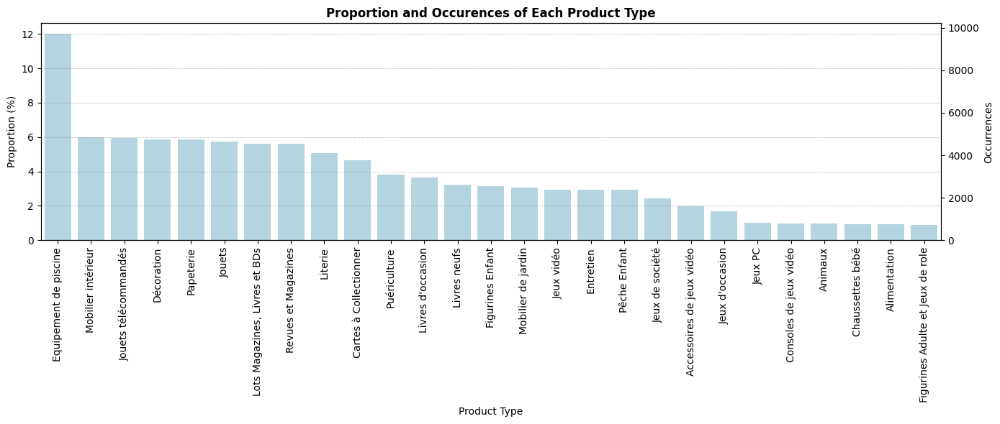


Distribution of products per product Type Code



,Product Type,Occurences
prdtypecode,,
2583,Equipement de piscine,10209
1560,Mobilier intérieur,5073
1300,Jouets télécommandés,5045
2060,Décoration,4993
2522,Papeterie,4989
1280,Jouets,4870
2403,"Lots Magazines, Livres et BDs",4774
2280,Revues et Magazines,4760
1920,Literie,4303


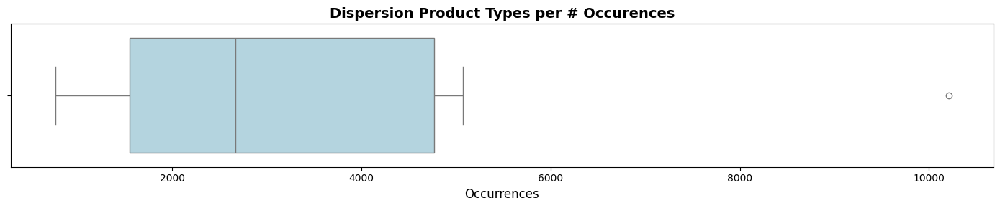

In [10]:
### 2. Distribution ###

prdtypecode_count_index = prdtypecode_count.index
prdtypecode_proportions = prdtypecode_count / len(X_train) * 100
prdtype_sorted_list = [prdtypes[code] for code in prdtypecode_count_index]

fig, ax1 = plt.subplots(figsize=(14, 6))
sns.barplot(
   x=prdtype_sorted_list,
   y=prdtypecode_proportions[prdtypecode_count_index],
   order=prdtype_sorted_list,
   color="lightblue",
   ax=ax1
)
ax1.set_ylabel('Proportion (%)')
ax1.set_xlabel('Product Type')
ax1.set_title('Proportion and Occurences of Each Product Type', fontweight='bold')
ax1.grid(True, axis='y', color='grey', linewidth=0.5, linestyle=':')
ax1.tick_params(axis='x', rotation=90)
ax2 = ax1.twinx()
ax2.set_ylabel('Occurrences')
ax2.set_ylim(0, prdtypecode_count[prdtypecode_count_index].max())

plt.tight_layout()
plt.show()

## Table

print("""\nDistribution of products per product Type Code\n""")
prdtypecode_count_df = pd.DataFrame({
    "Product Type": prdtype_sorted_list,
   "Occurences": prdtypecode_count
})
display(prdtypecode_count_df)

## Boxplot

plt.figure(figsize=(14, 3))
sns.boxplot(x=prdtypecode_count.values, color="lightblue")
plt.title("Dispersion Product Types per # Occurences", fontsize=14, fontweight='bold')
plt.xlabel("Occurrences", fontsize=12)
plt.tight_layout()
plt.show()

# Data inspection

## NaN descriptions

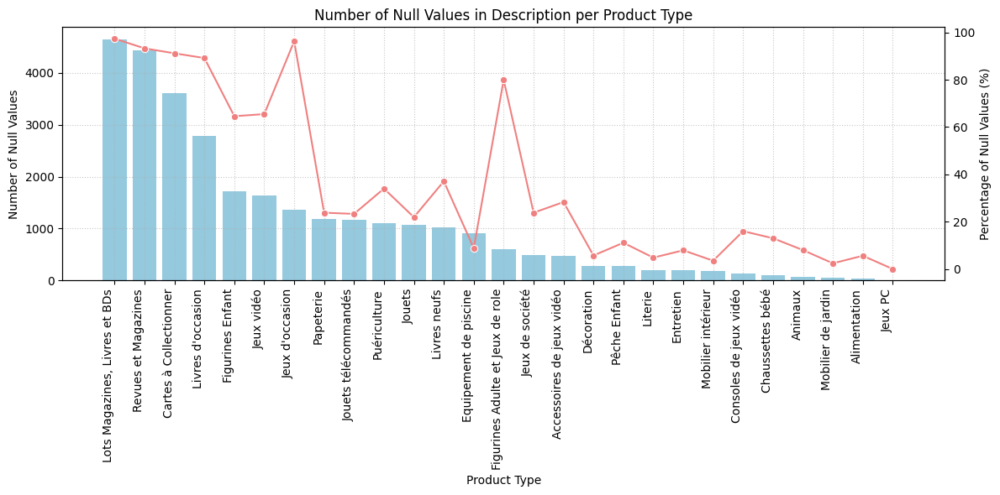

Number of Null Values in Description per Product Type


,prdtypecode,prdtype,null_descriptions_count,null_descriptions_pct
19,2403,"Lots Magazines, Livres et BDs",4648,97.4
20,2462,Jeux d'occasion,1368,96.3
18,2280,Revues et Magazines,4440,93.3
5,1160,Cartes à Collectionner,3604,91.2
0,10,Livres d'occasion,2778,89.2
6,1180,Figurines Adulte et Jeux de role,611,80.0
1,40,Jeux vidéo,1642,65.5
4,1140,Figurines Enfant,1726,64.6
25,2705,Livres neufs,1025,37.1
12,1320,Puériculture,1101,34.0


In [11]:
# Calculate the lengths of designation and description
X_train['designation_length'] = X_train['designation'].str.len()
X_train['description_length'] = X_train['description'].str.len()

# Group by 'prdtypecode' and count the null values in 'description' and total values
null_counts = X_train.groupby('prdtypecode').agg({
    'description': lambda x: x.isnull().sum(),
    'designation': 'count'
}).reset_index()

# Map 'prdtypecode' to 'prdtype' using the prdtypes dictionary
null_counts['prdtype'] = null_counts['prdtypecode'].map(prdtypes)

# Calculate the percentage of null values
null_counts['null_descriptions_pct'] = round((null_counts['description'] / null_counts['designation']) * 100, 1)

# Rename the columns for clarity
null_counts = null_counts.rename(columns={
    'description': 'null_descriptions_count',
    'designation': 'total_count'
})

# Select the desired columns
final_df = null_counts[['prdtypecode', 'prdtype', 'null_descriptions_count', 'null_descriptions_pct']]

# Sort the DataFrame by the number of null values in 'description' in descending order
final_df = final_df.sort_values('null_descriptions_count', ascending=False)

# Create a figure with a primary and secondary y-axis
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plot the number of null values in 'description' per product type on the primary y-axis
sns.barplot(data=final_df, x='prdtype', y='null_descriptions_count', ax=ax1, color='skyblue')
ax1.set_title('Number of Null Values in Description per Product Type')
ax1.set_xlabel('Product Type')
ax1.set_ylabel('Number of Null Values')

# Set the ticks and tick labels for the x-axis
ax1.set_xticks(range(len(final_df['prdtype'])))
ax1.set_xticklabels(final_df['prdtype'], rotation=90, ha='right')
plt.grid(True, linestyle=':', alpha=0.7)

# Create a secondary y-axis for the percentage of null values
ax2 = ax1.twinx()
sns.lineplot(data=final_df, x='prdtype', y='null_descriptions_pct', ax=ax2, color='lightcoral', marker='o')
ax2.set_ylabel('Percentage of Null Values (%)')

# Adjust layout to prevent clipping of labels
plt.tight_layout()

# Show the plot
plt.show()

# Display the final DataFrame sorted by percentage of null values in 'description'
final_df = final_df.sort_values('null_descriptions_pct', ascending=False)

print("Number of Null Values in Description per Product Type")
print("=" * 65)
display(final_df)


## Replicate descriptions

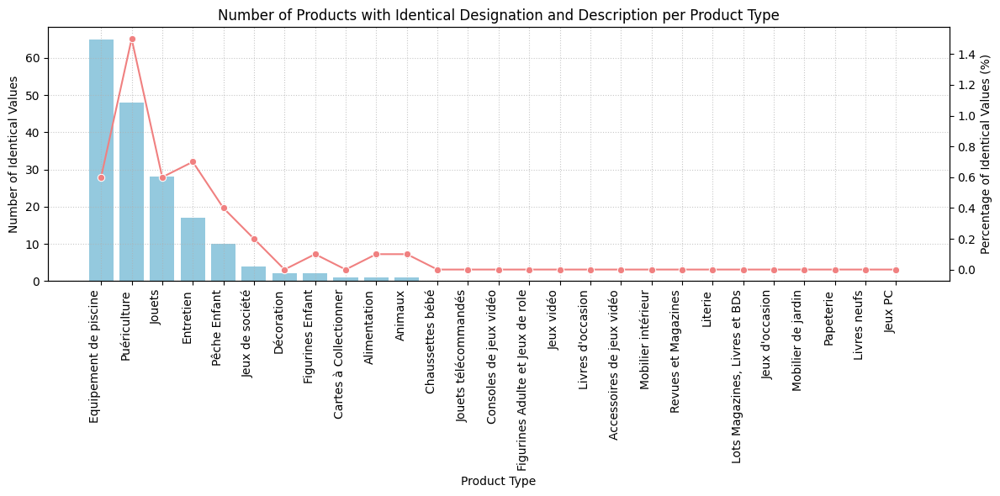

Number of Products with Identical Designation and Description per Product Type


,prdtypecode,prdtype,identical_count,identical_pct
12,1320,Puériculture,48,1.5
24,2585,Entretien,17,0.7
23,2583,Equipement de piscine,65,0.6
7,1280,Jouets,28,0.6
11,1302,Pêche Enfant,10,0.4
8,1281,Jeux de société,4,0.2
4,1140,Figurines Enfant,2,0.1
17,2220,Animaux,1,0.1
15,1940,Alimentation,1,0.1
16,2060,Décoration,2,0.0



Random Sample of 10 Products with Identical Designation and Description
There are 179 replicate products in total.


,prdtypecode,prdtype,designation,description
25512,2585,Entretien,Panier Hydro 5cm par 100 pcs,Panier Hydro 5cm par 100 pcs
64338,2583,Equipement de piscine,Flamant rose géant gonflable de Funshine - Jeu...,Flamant rose géant gonflable de Funshine - Jeu...
66336,2585,Entretien,Tuyau de Vidange évacuation 1.8 M pour Machine...,Tuyau de Vidange évacuation 1.8 M pour Machine...
27702,1320,Puériculture,Jerseybaby Jersey Bettwäsche Triangel Blue 80x...,Jerseybaby Jersey Bettwäsche Triangel Blue 80x...
80721,1320,Puériculture,Jerseybaby Schlafsack Cosy Crazy Animals 74/80,Jerseybaby Schlafsack Cosy Crazy Animals 74/80
14352,2583,Equipement de piscine,Bâche hiver ronde - Ø360 m de Astralpool - Bâc...,Bâche hiver ronde - Ø360 m de Astralpool - Bâc...
45985,1320,Puériculture,Jerseybaby Jerseydecke Herzchen Grau 120x120cm,Jerseybaby Jerseydecke Herzchen Grau 120x120cm
7755,2583,Equipement de piscine,Coffret NCC Mono de Espa - Accessoires NCC,Coffret NCC Mono de Espa - Accessoires NCC
42627,2583,Equipement de piscine,Enrouleur Éco télescopique 2 à 45 m de Astralp...,Enrouleur Éco télescopique 2 à 45 m de Astralp...
16355,1320,Puériculture,Selecta 1304 - Greifling Catina,Selecta 1304 - Greifling Catina


In [12]:
# Create a new column that checks if designation is identical to description
X_train['identical_designation_description'] = X_train['designation'] == X_train['description']

# Group by 'prdtypecode' and count the occurrences where designation is identical to description
identical_counts = X_train.groupby('prdtypecode').agg({
    'identical_designation_description': 'sum',
    'designation': 'count'
}).reset_index()

# Map 'prdtypecode' to 'prdtype' using the prdtypes dictionary
identical_counts['prdtype'] = identical_counts['prdtypecode'].map(prdtypes)

# Calculate the percentage of identical designation and description
identical_counts['identical_pct'] = round((identical_counts['identical_designation_description'] / identical_counts['designation']) * 100, 1)

# Rename the columns for clarity
identical_counts = identical_counts.rename(columns={
    'identical_designation_description': 'identical_count',
    'designation': 'total_count'
})

# Select the desired columns
final_df = identical_counts[['prdtypecode', 'prdtype', 'identical_count', 'identical_pct']]

# Sort the DataFrame by the number of identical values in descending order
final_df = final_df.sort_values('identical_count', ascending=False)

# Create a figure with a primary and secondary y-axis
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plot the number of identical values per product type on the primary y-axis
sns.barplot(data=final_df, x='prdtype', y='identical_count', ax=ax1, color='skyblue')
ax1.set_title('Number of Products with Identical Designation and Description per Product Type')
ax1.set_xlabel('Product Type')
ax1.set_ylabel('Number of Identical Values')

# Set the ticks and tick labels for the x-axis
ax1.set_xticks(range(len(final_df['prdtype'])))
ax1.set_xticklabels(final_df['prdtype'], rotation=90, ha='right')

ax1.grid(True, linestyle=':', alpha=0.7)

# Create a secondary y-axis for the percentage of identical values
ax2 = ax1.twinx()
sns.lineplot(data=final_df, x='prdtype', y='identical_pct', ax=ax2, color='lightcoral', marker='o')
ax2.set_ylabel('Percentage of Identical Values (%)')

# Adjust layout to prevent clipping of labels
plt.tight_layout()

# Show the plot
plt.show()

# Display the final DataFrame sorted by percentage of identical values
final_df = final_df.sort_values('identical_pct', ascending=False)

print("Number of Products with Identical Designation and Description per Product Type")
print("=" * 65)
display(final_df)

# GSsample of 20 products where description and designation are identical
replicate_products = X_train[X_train['identical_designation_description']]
replicate_products_count = replicate_products.shape[0]
print("\nRandom Sample of 10 Products with Identical Designation and Description")
print("=" * 65)
print(f'There are {replicate_products_count} replicate products in total.')
display(replicate_products[['prdtypecode', 'prdtype','designation', 'description']].sample(10))


## Duplicate designations and descriptions

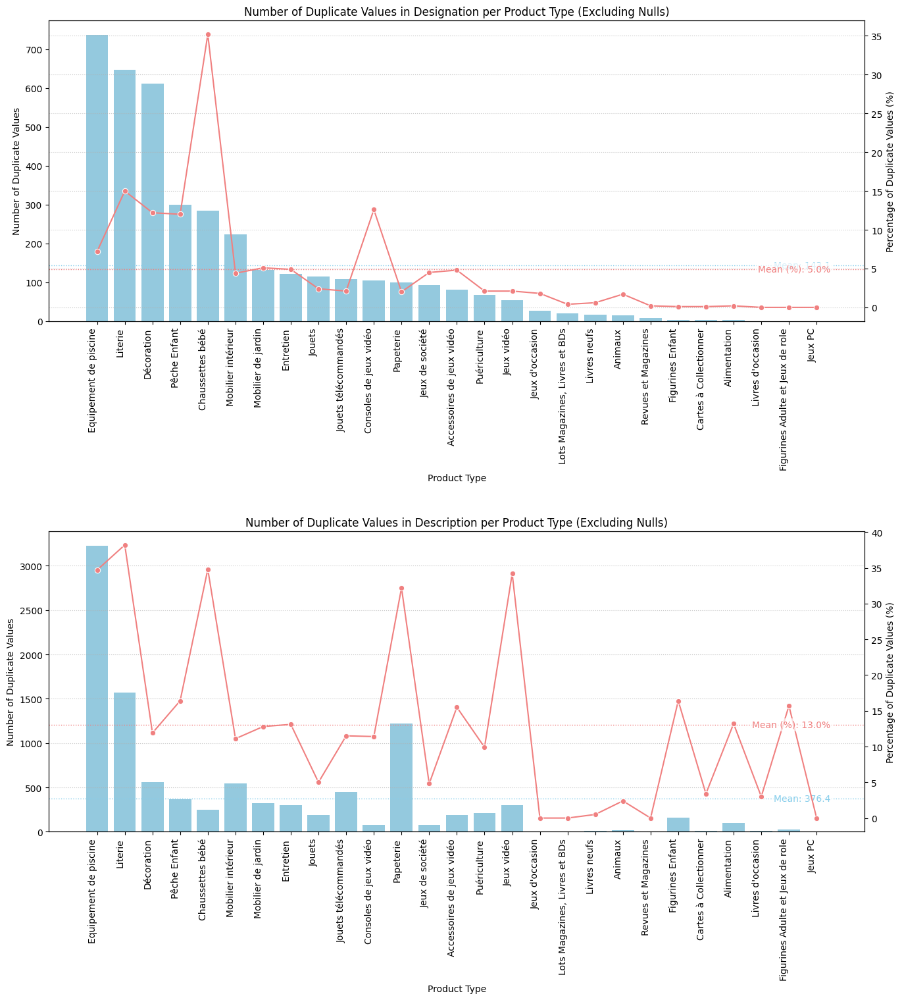

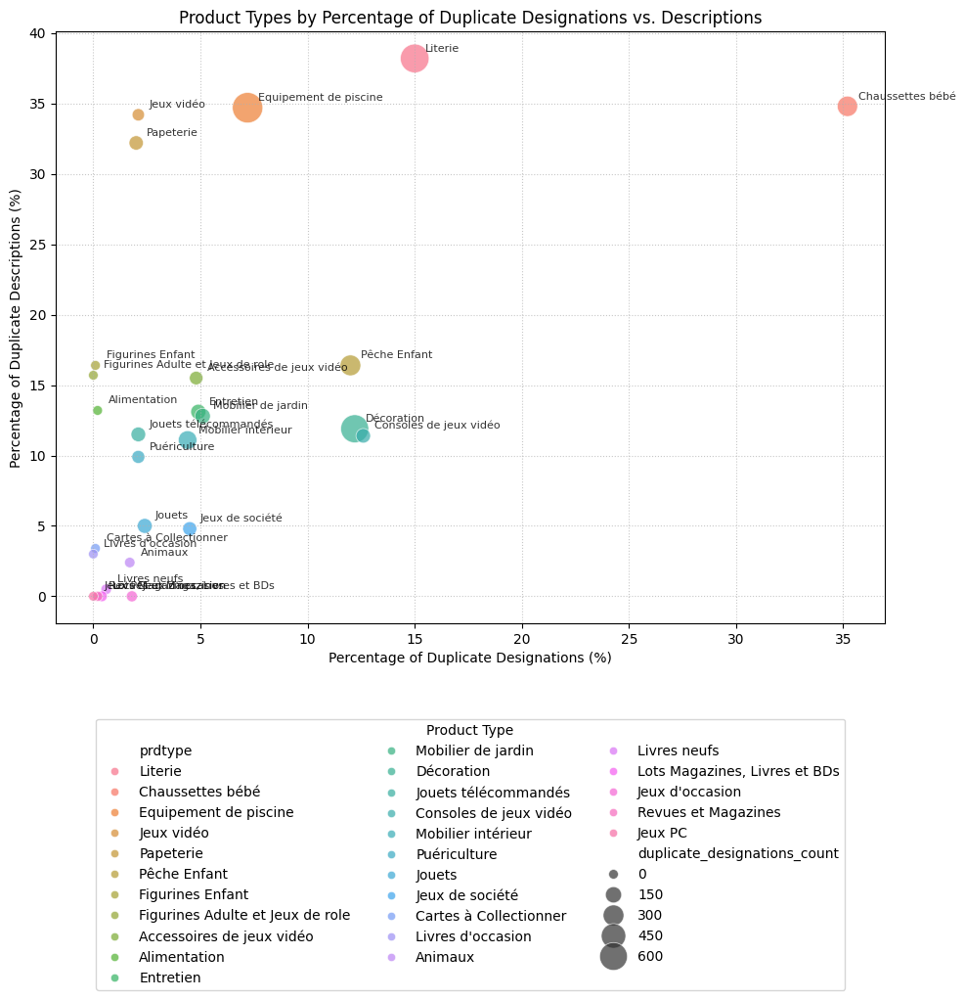


Number of Duplicate Values in Designation and Description per Product Type (Excluding Nulls)


,prdtypecode,prdtype,duplicate_designations_count,duplicate_designations_pct,duplicate_descriptions_count,duplicate_descriptions_pct
14,1920,Literie,647,15.0,1566,38.2
10,1301,Chaussettes bébé,284,35.2,244,34.8
23,2583,Equipement de piscine,737,7.2,3227,34.7
1,40,Jeux vidéo,53,2.1,296,34.2
21,2522,Papeterie,99,2.0,1222,32.2
11,1302,Pêche Enfant,299,12.0,364,16.4
4,1140,Figurines Enfant,2,0.1,155,16.4
6,1180,Figurines Adulte et Jeux de role,0,0.0,24,15.7
2,50,Accessoires de jeux vidéo,81,4.8,187,15.5
15,1940,Alimentation,2,0.2,100,13.2



Top 20 Most Duplicated Designations


,prdtypecode,prdtype,designation,duplicate_count
0,2060,Décoration,5d Broderie Peintures Strass Diamant Bricolage...,76
1,1920,Literie,Simple Linen Creative Belle Oreiller Taie D'or...,28
2,1920,Literie,Cotton Linen Place Décoratifs Pour La Maison C...,25
3,1560,Mobilier intérieur,Cotton Linen Place Décoratifs Pour La Maison C...,25
4,1920,Literie,Imprimer Taie Polyester Canapé Coussin Car Cov...,22
5,1920,Literie,Joyeuse Saint-Valentin Jetez Taie D'oreiller S...,21
6,1301,Chaussettes bébé,Enfants bébé tout-petits garçons Bébés filles ...,20
7,1302,Pêche Enfant,Poignée Design Impression Numérique 3d Full Po...,18
8,2583,Equipement de piscine,Liner sable ou bleu pour piscine allongée Ubbink,17
9,2060,Décoration,Creative Mobile Mur Avec Apposé Décoratif Mur ...,17



Top 20 Most Duplicated Descriptions


,prdtypecode,prdtype,description,duplicate_count
0,40,Jeux vidéo,<br>Attention !!! Ce produit est un import si...,252
1,2522,Papeterie,Taille: En format A5 (144 cm x 21 cm) Caractéi...,232
2,2522,Papeterie,Taille: En format A5 (144 cm x 21 cm) Caracter...,189
3,2522,Papeterie,Taille: En format A5 (144 cm x 21 cm) Caract?i...,162
4,2522,Papeterie,Taille: En format A5 (144 cm x 21 cm) Caractér...,89
5,1940,Alimentation,<br />,81
6,2522,Papeterie,<br />,81
7,1301,Chaussettes bébé,<br />,81
8,2583,Equipement de piscine,Piscine hors-sol en acier ronde Fidji de la ma...,57
9,2583,Equipement de piscine,Kit de piscine hors-sol ronde en acier Bora Bo...,39


In [13]:
# Calculate the lengths of designation and description
X_train['designation_length'] = X_train['designation'].str.len()
X_train['description_length'] = X_train['description'].str.len()

# Group by 'prdtypecode' and count the duplicate values in 'designation' and 'description'
duplicate_counts = X_train.groupby('prdtypecode').agg(
    designation_duplicates=pd.NamedAgg(column='designation', aggfunc=lambda x: x.dropna().duplicated(keep=False).sum()), # excluding null values
    description_duplicates=pd.NamedAgg(column='description', aggfunc=lambda x: x.dropna().duplicated(keep=False).sum()), # excluding null values
    designation_non_null_count=pd.NamedAgg(column='designation', aggfunc=lambda x: x.dropna().count()), # excluding null values
    description_non_null_count=pd.NamedAgg(column='description', aggfunc=lambda x: x.dropna().count()) # excluding null values
).reset_index()

# Map 'prdtypecode' to 'prdtype' using the prdtypes dictionary
duplicate_counts['prdtype'] = duplicate_counts['prdtypecode'].map(prdtypes)

# Calculate the percentage of duplicate values relative to the non-null counts
duplicate_counts['duplicate_designations_pct'] = round((duplicate_counts['designation_duplicates'] / duplicate_counts['designation_non_null_count']) * 100, 1)
duplicate_counts['duplicate_descriptions_pct'] = round((duplicate_counts['description_duplicates'] / duplicate_counts['description_non_null_count']) * 100, 1)

# Rename the columns for clarity
duplicate_counts = duplicate_counts.rename(columns={
    'designation_duplicates': 'duplicate_designations_count',
    'description_duplicates': 'duplicate_descriptions_count',
})

# Select the desired columns
final_df = duplicate_counts[['prdtypecode', 'prdtype', 'duplicate_designations_count', 'duplicate_designations_pct', 'duplicate_descriptions_count', 'duplicate_descriptions_pct']]

# Sort the DataFrame by the number of duplicate values in 'designation' in descending order
final_df = final_df.sort_values('duplicate_designations_count', ascending=False)

# Calculate Means for Duplicate Counts and Percentages
mean_designation_count = final_df['duplicate_designations_count'].mean()
mean_designation_pct = final_df['duplicate_designations_pct'].mean()
mean_description_count = final_df['duplicate_descriptions_count'].mean()
mean_description_pct = final_df['duplicate_descriptions_pct'].mean()

### Plotting the bar plots ###

# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 16))
plt.subplots_adjust(hspace=0.5, wspace=0.3) # Initial subplot spacing

# Get the x_labels from the sorted final_df for consistent plotting
x_labels = final_df['prdtype']

# --- Plot for Designation Duplicates ---
sns.barplot(data=final_df, x='prdtype', y='duplicate_designations_count', ax=ax1, color='skyblue')
ax1.set_title('Number of Duplicate Values in Designation per Product Type (Excluding Nulls)')
ax1.set_xlabel('Product Type')
ax1.set_ylabel('Number of Duplicate Values')
ax1.set_xticks(range(len(x_labels)))
ax1.set_xticklabels(x_labels, rotation=90, ha='right')
plt.grid(True, linestyle=':', alpha=0.7)

# Add mean line for designation count
ax1.axhline(mean_designation_count, color='skyblue', linestyle=':', linewidth=1)
ax1.text(
    x=len(x_labels) - 0.5, # Position x slightly before the right edge of the last bar
    y=mean_designation_count,
    s=f'Mean: {mean_designation_count:.1f}',
    color='skyblue',
    ha='right',
    va='center',
    fontsize=10,
    bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', boxstyle='round,pad=0.2')
)

# Secondary y-axis for percentage of duplicate designations
ax1_twin = ax1.twinx()
sns.lineplot(data=final_df, x='prdtype', y='duplicate_designations_pct', ax=ax1_twin, color='lightcoral', marker='o')
ax1_twin.set_ylabel('Percentage of Duplicate Values (%)')

# Add mean line for designation percentage
ax1_twin.axhline(mean_designation_pct, color='lightcoral', linestyle=':', linewidth=1)
ax1_twin.text(
    x=len(x_labels) - 0.5,
    y=mean_designation_pct,
    s=f'Mean (%): {mean_designation_pct:.1f}%',
    color='lightcoral',
    ha='right',
    va='center',
    fontsize=10,
    bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', boxstyle='round,pad=0.2')
)

# --- Plot for Description Duplicates ---
sns.barplot(data=final_df, x='prdtype', y='duplicate_descriptions_count', ax=ax2, color='skyblue')
ax2.set_title('Number of Duplicate Values in Description per Product Type (Excluding Nulls)')
ax2.set_xlabel('Product Type')
ax2.set_ylabel('Number of Duplicate Values')
ax2.set_xticks(range(len(x_labels)))
ax2.set_xticklabels(x_labels, rotation=90, ha='right')
plt.grid(True, linestyle=':', alpha=0.7)

# Add mean line for description count
ax2.axhline(mean_description_count, color='skyblue', linestyle=':', linewidth=1)
ax2.text(
    x=len(x_labels) - 0.5,
    y=mean_description_count,
    s=f'Mean: {mean_description_count:.1f}',
    color='skyblue',
    ha='right',
    va='center',
    fontsize=10,
    bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', boxstyle='round,pad=0.2')
)

# Secondary y-axis for percentage of duplicate descriptions
ax2_twin = ax2.twinx()
sns.lineplot(data=final_df, x='prdtype', y='duplicate_descriptions_pct', ax=ax2_twin, color='lightcoral', marker='o')
ax2_twin.set_ylabel('Percentage of Duplicate Values (%)')

# Add mean line for description percentage
ax2_twin.axhline(mean_description_pct, color='lightcoral', linestyle=':', linewidth=1)
ax2_twin.text(
    x=len(x_labels) - 0.5,
    y=mean_description_pct,
    s=f'Mean (%): {mean_description_pct:.1f}%',
    color='lightcoral',
    ha='right',
    va='center',
    fontsize=10,
    bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', boxstyle='round,pad=0.2')
)

plt.subplots_adjust(hspace=0.7) # Apply spacing between the two main subplots
plt.show()

# Display the final DataFrame sorted by percentage of duplicate values in 'description'
final_df = final_df.sort_values('duplicate_descriptions_pct', ascending=False)

### Plotting the scatter plot ###

plt.figure(figsize=(10, 12)) # Set a good size for the scatter plot
sns.scatterplot(
    data=final_df,
    x='duplicate_designations_pct',
    y='duplicate_descriptions_pct',
    hue='prdtype',
    size='duplicate_designations_count',
    sizes=(50, 500), # Define the range of marker sizes
    alpha=0.7, # Add transparency for overlapping points
    ax=plt.gca() # Use the current axes for the plot
)

plt.title('Product Types by Percentage of Duplicate Designations vs. Descriptions')
plt.xlabel('Percentage of Duplicate Designations (%)')
plt.ylabel('Percentage of Duplicate Descriptions (%)')
plt.grid(None, linestyle=':', alpha=0.7)

# Add annotations for each point (product type name)
for i, row in final_df.iterrows():
    plt.text(
        row['duplicate_designations_pct'] + 0.5, # Slightly offset text from the point
        row['duplicate_descriptions_pct'] + 0.5,
        row['prdtype'],
        fontsize=8,
        alpha=0.8
    )

plt.legend(title='Product Type', bbox_to_anchor=(0.5, -0.15), loc='upper center', ncol=3)
plt.tight_layout(rect=[0, 0.1, 1, 1]) # Adjust tight_layout to make space for the legend below. Increased bottom space.
plt.show()

### Final Df ###
print("\nNumber of Duplicate Values in Designation and Description per Product Type (Excluding Nulls)")
print("=" * 75)
display(final_df)

### Display the 20 most duplicated designations and descriptions ###

# Get the top 20 most duplicated designations
top_20_duplicated_designations = X_train[X_train.duplicated(subset=['designation'], keep=False)].groupby('designation').size().reset_index(name='duplicate_count').sort_values('duplicate_count', ascending=False).head(20)

# Merge with the original DataFrame to get product type information
top_20_duplicated_designations = top_20_duplicated_designations.merge(X_train[['designation', 'prdtypecode']].drop_duplicates(), on='designation', how='left')
top_20_duplicated_designations['prdtype'] = top_20_duplicated_designations['prdtypecode'].map(prdtypes)

# Get the top 20 most duplicated descriptions
top_20_duplicated_descriptions = X_train[X_train.duplicated(subset=['description'], keep=False)].groupby('description').size().reset_index(name='duplicate_count').sort_values('duplicate_count', ascending=False).head(20)

# Merge with the original DataFrame to get product type information
top_20_duplicated_descriptions = top_20_duplicated_descriptions.merge(X_train[['description', 'prdtypecode']].drop_duplicates(), on='description', how='left')
top_20_duplicated_descriptions['prdtype'] = top_20_duplicated_descriptions['prdtypecode'].map(prdtypes)

print("\nTop 20 Most Duplicated Designations")
print("=" * 75)
display(top_20_duplicated_designations[['prdtypecode', 'prdtype', 'designation', 'duplicate_count']])

print("\nTop 20 Most Duplicated Descriptions")
print("=" * 75)
display(top_20_duplicated_descriptions[['prdtypecode', 'prdtype', 'description', 'duplicate_count']])


# Designation and description length analysis

## Designation and description lengths overview

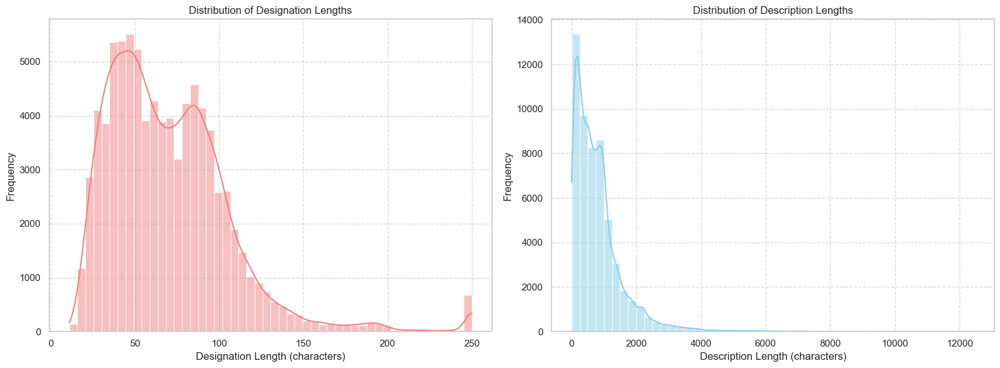

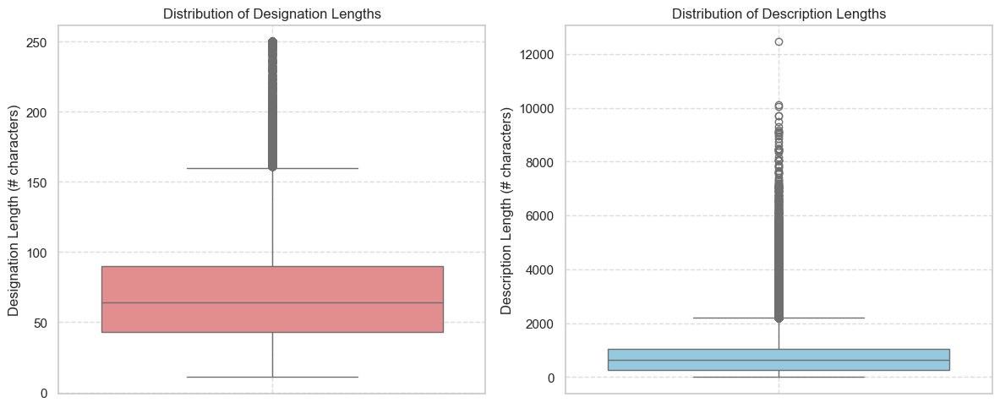

In [14]:
# Set the style of the plots
sns.set(style="whitegrid")

### Barplots ###

# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Plot the distribution of designation lengths
sns.histplot(X_train['designation'].str.len(), bins=50, kde=True, color='lightcoral', ax=ax1)
ax1.set_title('Distribution of Designation Lengths')
ax1.set_xlabel('Designation Length (characters)')
ax1.set_ylabel('Frequency')
ax1.grid(True, linestyle='--', alpha=0.7)

# Plot the distribution of description lengths
sns.histplot(X_train['description'].str.len(), bins=50, kde=True, color='skyblue', ax=ax2)
ax2.set_title('Distribution of Description Lengths')
ax2.set_xlabel('Description Length (characters)')
ax2.set_ylabel('Frequency')
ax2.grid(True, linestyle='--', alpha=0.7)

# Adjust layout to prevent clipping of labels
plt.tight_layout()

# Show the plots
plt.show()

### Boxplots ###

# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

# Plot the boxplot of designation lengths
sns.boxplot(y=X_train['designation'].str.len(), color='lightcoral', ax=ax1)
ax1.set_title('Distribution of Designation Lengths')
ax1.set_ylabel('Designation Length (# characters)')
ax1.grid(True, linestyle='--', alpha=0.7)

# Plot the boxplot of description lengths
sns.boxplot(y=X_train['description'].str.len(), color='skyblue', ax=ax2)
ax2.set_title('Distribution of Description Lengths')
ax2.set_ylabel('Description Length (# characters)')
ax2.grid(True, linestyle='--', alpha=0.7)

# Adjust layout to prevent clipping of labels
plt.tight_layout()

# Show the plots
plt.show()

## Designation and description lengths by product type

Average Length of Designation and Description per Product Type:


,prdtypecode,prdtype,avg_designation_length,avg_description_length
0,2280,Revues et Magazines,110.0,239.0
1,60,Consoles de jeux vidéo,108.0,300.0
2,1300,Jouets télécommandés,92.0,997.0
3,2060,Décoration,86.0,1074.0
4,1560,Mobilier intérieur,83.0,956.0
5,1920,Literie,78.0,776.0
6,2220,Animaux,75.0,815.0
7,2585,Entretien,75.0,962.0
8,1301,Chaussettes bébé,75.0,583.0
9,1280,Jouets,73.0,806.0


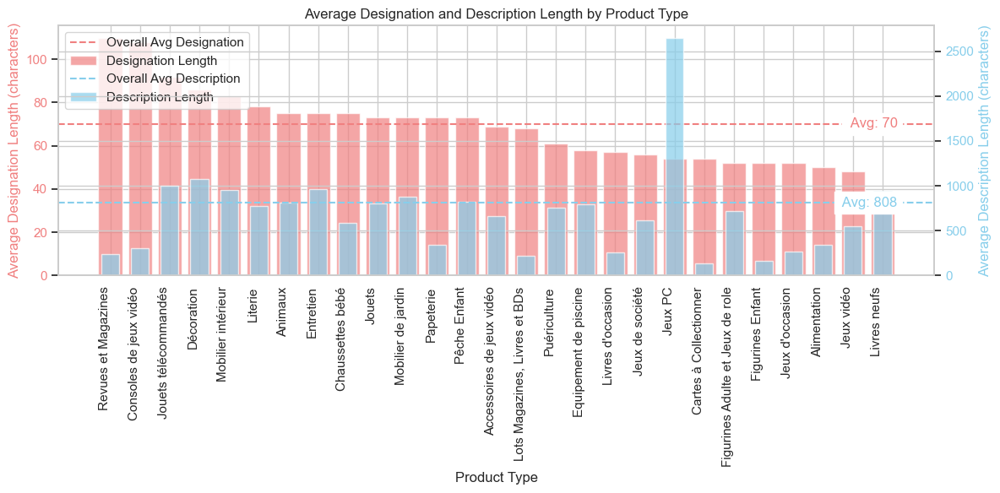


Summary Statistics:
Overall average designation length: 70.16
Overall average description length: 808.17
Number of unique product types: 27


In [15]:
### Table ###

# Group by 'prdtypecode' and calculate the average lengths of 'designation' and 'description'
avg_lengths = X_train.groupby('prdtypecode').agg({
    'designation': lambda x: x.str.len().mean(),
    'description': lambda x: x.str.len().mean()
}).round(0)

avg_lengths.columns = ['avg_designation_length', 'avg_description_length']

# Sort by average designation length descending
avg_lengths = avg_lengths.sort_values('avg_designation_length', ascending=False)

# Reset index to make 'prdtypecode' a column and map 'prdtypecode' to 'prdtype' using the prdtypes dictionary
avg_lengths = avg_lengths.reset_index()
avg_lengths['prdtype'] = avg_lengths['prdtypecode'].map(prdtypes)

# Move 'prdtype' to the right of 'prdtypecode'
columns = avg_lengths.columns.tolist()
columns.insert(1, columns.pop(columns.index('prdtype')))
avg_lengths = avg_lengths[columns]

print("Average Length of Designation and Description per Product Type:")
print("=" * 65)
display(avg_lengths)

### Graph ###

# Create a single plot with two y-axes
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plot designation length on left y-axis
color1 = 'lightcoral'
ax1.set_xlabel('Product Type')
ax1.set_ylabel('Average Designation Length (characters)', color=color1)
bars1 = ax1.bar(range(len(avg_lengths)), avg_lengths['avg_designation_length'],
                color=color1, alpha=0.7, label='Designation Length')
ax1.tick_params(axis='y', labelcolor=color1)

# Create second y-axis for description length
ax2 = ax1.twinx()
color2 = 'skyblue'
ax2.set_ylabel('Average Description Length (characters)', color=color2)
bars2 = ax2.bar(range(len(avg_lengths)), avg_lengths['avg_description_length'],
                color=color2, alpha=0.7, width=0.6, label='Description Length')
ax2.tick_params(axis='y', labelcolor=color2)

# Set x-axis labels
ax1.set_xticks(range(len(avg_lengths)))
ax1.set_xticklabels(avg_lengths['prdtype'], rotation=90, ha='right')

# Add title and legend
ax1.set_title('Average Designation and Description Length by Product Type')

# Calculate overall averages
overall_avg_designation = X_train['designation'].str.len().mean()
overall_avg_description = X_train['description'].str.len().mean()

# Add average lines
ax1.axhline(y=overall_avg_designation, color=color1, linestyle='--', label='Overall Avg Designation')
ax2.axhline(y=overall_avg_description, color=color2, linestyle='--', label='Overall Avg Description')

# Add labels for the average lines
ax1.text(len(avg_lengths) - 0.5, overall_avg_designation, f' Avg: {overall_avg_designation:.0f}', color=color1, va='center', ha='right', backgroundcolor='white')
ax2.text(len(avg_lengths) - 0.5, overall_avg_description, f' Avg: {overall_avg_description:.0f}', color=color2, va='center', ha='right', backgroundcolor='white')

# Add legends
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper left')

plt.tight_layout()
plt.show()

# Additional statistics
print(f"\nSummary Statistics:")
print(f"Overall average designation length: {overall_avg_designation:.2f}")
print(f"Overall average description length: {overall_avg_description:.2f}")
print(f"Number of unique product types: {X_train['prdtypecode'].nunique()}")

In [16]:
for prdtypecode in unique_prdtypecodes:
    # Filter the DataFrame for the current prdtypecode
    subset = X_train[X_train['prdtypecode'] == prdtypecode]

    # Get the corresponding prdtype
    prdtype = prdtypes.get(prdtypecode, "Unknown")

    # Create a figure with three subplots side by side
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))

    # Plot the histplot of designation lengths
    sns.histplot(subset['designation'].dropna().str.len(), bins=50, kde=True, color='lightcoral', ax=ax1)
    ax1.set_title(f'Designation Length Distribution for {prdtype} (Code: {prdtypecode})')
    ax1.set_xlabel('Designation Length (characters)')
    ax1.set_ylabel('Frequency')
    ax1.grid(True, linestyle='--', alpha=0.7)

    # Plot the histplot of description lengths
    sns.histplot(subset['description'].dropna().str.len(), bins=50, kde=True, color='skyblue', ax=ax2)
    ax2.set_title(f'Description Length Distribution for {prdtype} (Code: {prdtypecode})')
    ax2.set_xlabel('Description Length (characters)')
    ax2.set_ylabel('Frequency')
    ax2.grid(True, linestyle='--', alpha=0.7)

    # Plot the boxplot of designation and description lengths
    sns.boxplot(data=[subset['designation'].dropna().str.len(), subset['description'].dropna().str.len()],
                palette=['lightcoral', 'skyblue'], ax=ax3)
    ax3.set_title(f'Designation and Description Lengths for {prdtype} (Code: {prdtypecode})')

    # Set the ticks and tick labels for the boxplot
    ax3.set_xticks([0, 1])
    ax3.set_xticklabels(['Designation', 'Description'])

    ax3.set_ylabel('Length (characters)')
    ax3.grid(True, linestyle='--', alpha=0.7)

    # Adjust layout to prevent clipping of labels
    plt.tight_layout()

    # Show the plots
    plt.show()


NameError: name 'unique_prdtypecodes' is not defined

## Designation and description length correlation analysis

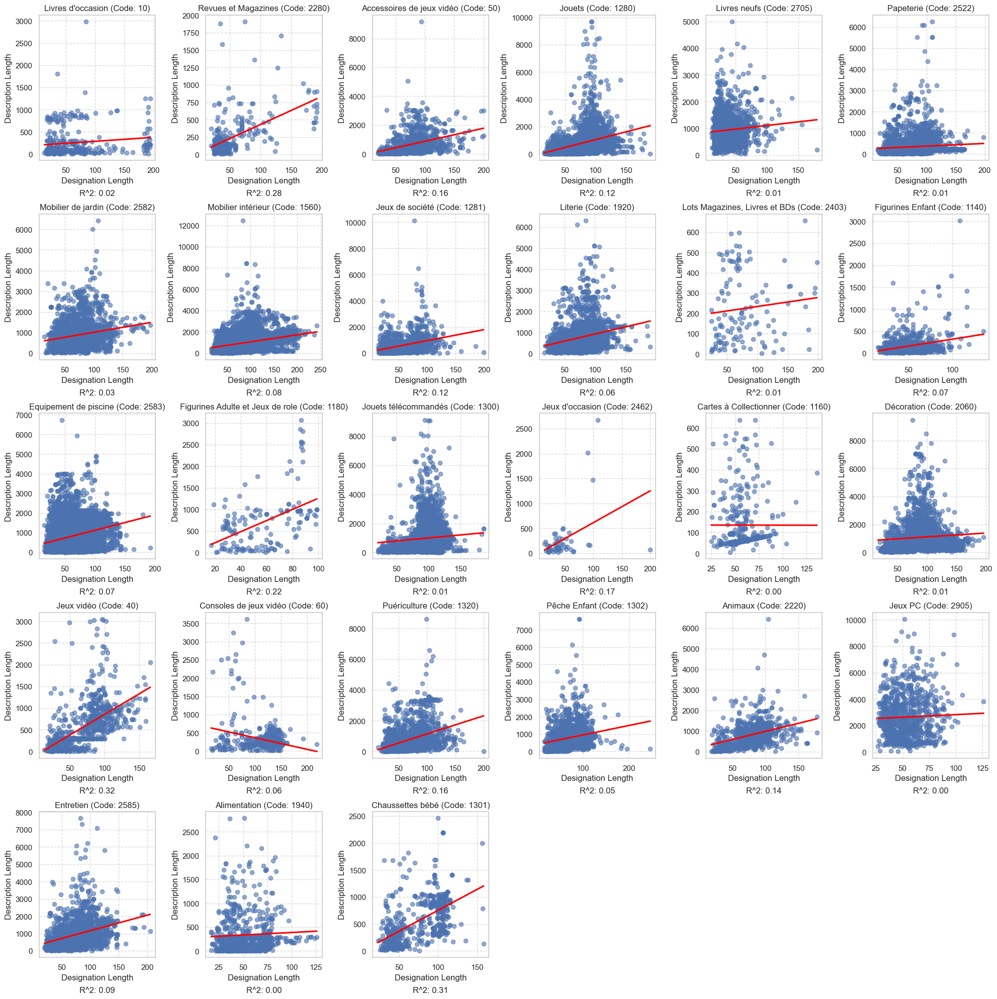

In [17]:
# Calculate the lengths of designation and description
X_train['designation_length'] = X_train['designation'].str.len()
X_train['description_length'] = X_train['description'].str.len()

# Get unique prdtypecode values
unique_prdtypecodes = X_train['prdtypecode'].unique()

# Determine the grid size for the subplots
n = len(unique_prdtypecodes)
n_cols = 6  # Number of columns in the grid
n_rows = int(np.ceil(n / n_cols))  # Number of rows in the grid

# Create a figure with subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 20))  # Increased figsize

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Iterate over each prdtypecode
for i, prdtypecode in enumerate(unique_prdtypecodes):
    # Filter the DataFrame for the current prdtypecode
    subset = X_train[X_train['prdtypecode'] == prdtypecode]

    # Get the corresponding prdtype
    prdtype = prdtypes.get(prdtypecode, "Unknown")

    # Drop rows with NaN values
    subset_clean = subset.dropna(subset=['designation_length', 'description_length'])

    # Calculate the R-squared value
    x = subset_clean['designation_length']
    y = subset_clean['description_length']
    slope, intercept, r_value, p_value, std_err = linregress(x, y)
    y_pred = intercept + slope * x
    r_squared = r2_score(y, y_pred)

    # Create a scatter plot with regression line
    sns.regplot(data=subset_clean, x='designation_length', y='description_length', scatter_kws={'alpha':0.6}, line_kws={'color':'red'}, ci=None, ax=axes[i])
    axes[i].set_title(f'{prdtype} (Code: {prdtypecode})')
    axes[i].set_xlabel('Designation Length')
    axes[i].set_ylabel('Description Length')
    axes[i].grid(True, linestyle='--', alpha=0.7)

    # Add text with R-squared and p-value
    axes[i].text(0.5, -0.2, f'R^2: {r_squared:.2f}',
                 transform=axes[i].transAxes, ha='center', va='top')

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')
    
# Adjust layout to prevent clipping of labels
plt.tight_layout()

# Show the plots
plt.show()


# Image inspection

In [19]:
# Path to the image directory
IMAGE_DATA_PATH = '../data/images/'
image_directory = os.path.join(IMAGE_DATA_PATH, 'image_train')

# Regular expression pattern to match image filenames
pattern = re.compile(r'image_(\d+)_product_(\d+)\.jpg')

# Lists to store data for the DataFrame and unique sizes and formats
data_for_dataframe = []
unique_sizes = set()
unique_formats = set()

# Iterate over each file in the image directory
for image_file_name in os.listdir(image_directory):
    match = pattern.match(image_file_name)
    if match:
        imageid = match.group(1)
        productid = match.group(2)
        full_image_path = os.path.join(image_directory, image_file_name)

        # Open the image to get its properties
        with Image.open(full_image_path) as img:
            width, height = img.size
            format = img.format
            size_bytes = os.path.getsize(full_image_path)  # Size in bytes
            size_kb = round(size_bytes / 1024, 2)  # Size in KB

            # Add the size and format to the sets for uniqueness
            unique_sizes.add((width, height))
            unique_formats.add(format)

        # Append the data to the list
        data_for_dataframe.append({
            'productid': productid,
            'imageid': imageid,
            'imagepath': full_image_path,
            'width': width,
            'height': height,
            'format': format,
            'size_bytes': size_bytes,
            'size_kb': size_kb
        })

# Create the DataFrame
df = pd.DataFrame(data_for_dataframe)

# Display the number of images, unique image sizes, and unique image formats
print(f"Number of images: {len(df)}")
print(f"Unique image sizes: {unique_sizes}")
print(f"Number of unique image sizes: {len(unique_sizes)}")
print(f"Unique image formats: {unique_formats}")
print(f"Number of unique image formats: {len(unique_formats)}")

Number of images: 84916
Unique image sizes: {(500, 500)}
Number of unique image sizes: 1
Unique image formats: {'JPEG'}
Number of unique image formats: 1


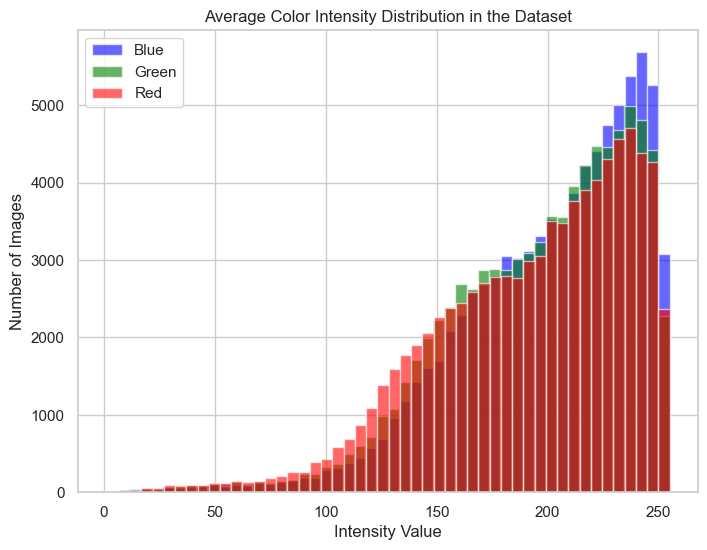

In [20]:
# NOTE: LONG EXECUTION TIME

from concurrent.futures import ThreadPoolExecutor
# Function to process each image
def process_image(image_file_name):
    full_image_path = os.path.join(image_directory, image_file_name)
    with Image.open(full_image_path) as img:
        img_array = np.array(img)
        avg_color = np.mean(img_array, axis=(0, 1))
        return avg_color

# List to store average colors
avg_colors = []

# List of image filenames
image_files = [f for f in os.listdir(image_directory) if pattern.match(f)]

# Use ThreadPoolExecutor to process images in parallel
with ThreadPoolExecutor() as executor:
    avg_colors = list(executor.map(process_image, image_files))

# Convert the list of average colors to a numpy array
avg_colors = np.array(avg_colors)

# Plot histograms of the average color intensities
plt.figure(figsize=(8, 6))
plt.hist(avg_colors[:, 0], bins=50, color='blue', alpha=0.6, label='Blue')
plt.hist(avg_colors[:, 1], bins=50, color='green', alpha=0.6, label='Green')
plt.hist(avg_colors[:, 2], bins=50, color='red', alpha=0.6, label='Red')
plt.title("Average Color Intensity Distribution in the Dataset")
plt.xlabel("Intensity Value")
plt.ylabel("Number of Images")
plt.legend()
plt.show()

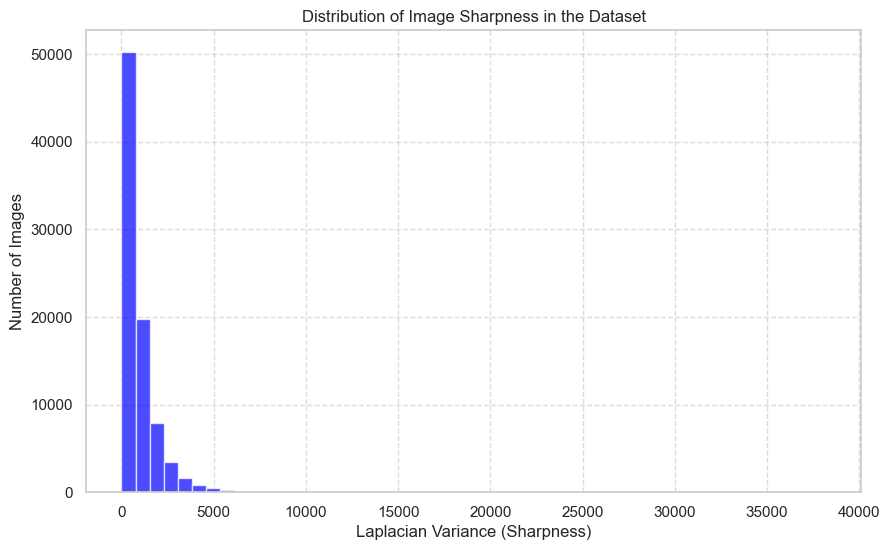

In [26]:
# NOTE: LONG EXECUTION TIME
import cv2

# List to store sharpness values
sharpness_values = []

# Function to compute Laplacian variance for sharpness
def compute_sharpness(image_path):
    image = cv2.imread(image_path)
    if image is not None:
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        return cv2.Laplacian(gray, cv2.CV_64F).var()
    return None

# Compute sharpness for each image
for img in image_files:
    image_path = os.path.join(image_directory, img)
    sharpness = compute_sharpness(image_path)
    if sharpness is not None:
        sharpness_values.append(sharpness)

# Plot the distribution of sharpness values
plt.figure(figsize=(10, 6))
plt.hist(sharpness_values, bins=50, color='blue', alpha=0.7)
plt.title("Distribution of Image Sharpness in the Dataset")
plt.xlabel("Laplacian Variance (Sharpness)")
plt.ylabel("Number of Images")
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()




------ df_images ------



,productid,imageid,width,height,format,size_bytes,size_kb,image
0,225316867,957799376,500,500,JPEG,19222,18.77,
1,1657063044,1096607531,500,500,JPEG,8536,8.34,
2,4114874553,1292934363,500,500,JPEG,25606,25.01,
3,3929899369,1265222564,500,500,JPEG,5988,5.85,
4,2210607625,1153038274,500,500,JPEG,25237,24.65,
5,145599498,899898058,500,500,JPEG,34328,33.52,
6,1108140649,1061832913,500,500,JPEG,13259,12.95,
7,4167127475,1306069150,500,500,JPEG,34473,33.67,
8,1534816034,1148436700,500,500,JPEG,40385,39.44,
9,3569043859,1222138970,500,500,JPEG,23889,23.33,

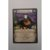
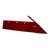
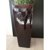
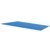
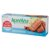
...
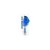
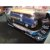
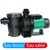
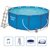
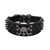

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84916 entries, 0 to 84915
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   84916 non-null  int64 
 1   prdtypecode  84916 non-null  int64 
 2   prdtype      84916 non-null  object
dtypes: int64(2), object(1)
memory usage: 1.9+ MB


None


Duplicates:
0


In [37]:
# Converting jpg images

def create_base64_thumbnail(image_path, size=(50, 50)):
    try:
        with Image.open(image_path) as img:
            img.thumbnail(size)
            img_byte_arr = io.BytesIO()
            img.save(img_byte_arr, format='JPEG', quality=85)
            encoded_img = base64.b64encode(img_byte_arr.getvalue()).decode('ascii')
            return f'<img src="data:image/jpeg;base64,{encoded_img}" alt="thumbnail" style="max-width:{size[0]}px; max-height:{size[1]}px; border:1px solid #ddd;"/>'
    except Exception as e:
        print(f"Error processing image {image_path}: {e}")
        return None

df['image'] = df['imagepath'].apply(create_base64_thumbnail)
df['productid'] = pd.to_numeric(df['productid'])
df['imageid'] = pd.to_numeric(df['imageid'])

df_images = df.drop("imagepath", axis=1)
df_images_head = df_images.head(40)
df_images_head = HTML(df_images_head.to_html(escape=False))

print(f"\n\n\n------ df_images ------\n");
display(df_images_head);
display(table.info());
print(f"\nDuplicates:\n{table.duplicated().sum()}")


## Merging and sorting tables

In [ ]:
X_train = X_train.merge(Y_train, how='left', left_index=True, right_index=True, suffixes=('_X_train', '_Y_train'))

# Merging df_images to X_train on productid and imageid
X_train = X_train.merge(df_images, on=['productid', 'imageid'], how='left', suffixes=('_X_train', '_df_images'))

# Dropping specified columns
X_train.drop(['Unnamed: 0_X_train', 'Unnamed: 0_Y_train', 'Unnamed: 0_df_images', 'prdtypecode_X_train', 'prdtypecode_Y_train', 'prdtypecode_df_images'], axis=1, inplace=True, errors='ignore')

# Sorting X_train by 'prdtypecode' in descending order and then by 'productid' in ascending order
#X_train.sort_values(by=['prdtypecode', 'productid'], ascending=[False, True], inplace=True)

# Display the first 10 rows of the resulting DataFrame
display(X_train.head(10))

In [ ]:
X_train.head(5)
